#RAT GANGS OF NEW YORK. 🌆 🐀
The main objective of this project is to utilize data sets from the [NYC Open Data](https://opendata.cityofnewyork.us/) repository to create a system to better combat rat infestations in the island of Manhattan by being able to predict future infestations. For this rat inspection data, geografic location of buildings and parks (and their shapes) and ABCEats restaurant inspections and subway line track locations are utilized.

##Setup

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
cd drive/MyDrive/Research_Bryant/NYC_Rats/

/content/drive/MyDrive/Research_Bryant/NYC_Rats


Load all the necessary libraries and install does not previously installed by Google.

In [ ]:
from IPython.display import clear_output

In [ ]:
!pip install geopandas #pip is called to install packages not mantained by google
!pip install contextily
clear_output()

In [ ]:
from math import radians, cos, sin, asin, sqrt, acos, degrees
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import folium
import geopandas as gpd
from pyproj import Proj, transform
import contextily as cx
import seaborn as sns; sns.set_theme()
from shapely.geometry import Polygon, Point, LineString
import networkx
from datetime import datetime
import sklearn as skl
from scipy.spatial.distance import minkowski
import folium
from branca.element import Figure
import plotly.express as px
from sklearn import cluster
import sklearn.linear_model as skl_linear
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, plot_confusion_matrix
from scipy.spatial import cKDTree
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.decomposition import PCA

##Creating building proximity matrix
Entries in the matrix indiacte the distance between two buildings if this is below 180 meters, any distance greater than this is set to zero.

In [ ]:
data_mat = pd.read_csv('manhattan_island_unique_bbl_long_lat.csv', delimiter=' ') #USE data_fetcher.py to extract data from coinbase api
df = pd.DataFrame(data_mat)

In [ ]:
l, w = df.shape
AM = np.zeros((l,l))

In [ ]:
skip1 = 0
skip2 = 0
for i in range(0,l):
  for j in range(0,l):
    if i!=j:
      D = haversine(df['Longitude'][i],df['Latitude'][i],df['Longitude'][j],df['Latitude'][j])
      skip2 = skip2 +1
      if D < 0.182:
        AM[i,j]=D
        skip1 = skip1 + 1
        if skip1 > 100:
          j = l - 1
          skip1 = 0
      if skip2 > 1000:
        j = l - 1
        skip2 = 0

In [ ]:
np.savez_compressed('Building_distance_180meter_threshold.npz',AM)

In [ ]:
gpd.GeoDataFrame.to_wkt

##Loading data

Here the [Rodent Inspection data](https://data.cityofnewyork.us/Health/Rodent-Inspection/p937-wjvj) is imported.

Only dates later than 01/01/2017 (to have enough ABCEats data) and before 03/02/2020 (to not have Covid dynamics influence our analysis). The data is filtered to only contain information for buildings in the borough of Manhattan. The reports data-frame that is created from this data is organized by latitude and longitude for faster search when looking for reports per local regions in Manhattan.

In [ ]:
data_mat = pd.read_csv('Rodent_Inspection.csv')
df = pd.DataFrame(data_mat)
df = df[df.BOROUGH == 'Manhattan']
df = df[df.BBL < 1099999999]
df['INSPECTION_DATE'] = pd.to_datetime(df['INSPECTION_DATE'], format='%m/%d/%Y %I:%M:%S %p')#.timestamp()
mask = (df['INSPECTION_DATE'] > '01/01/2018 6:00:00 AM') & (df['INSPECTION_DATE'] <= '03/07/2020 6:00:00 AM')
df = df.loc[mask]
mask = (df['LATITUDE'] != 0) & (pd.notna(df['LATITUDE']))
df = df.loc[mask]
df = df.sort_values(['LATITUDE', 'LONGITUDE'], ascending=[False, True])
df_reports = df
df_reports = df_reports.reset_index(drop=True)
del df
del data_mat
print ("There are "+str(df_reports.shape[0])+" reports each with "+str(df_reports.shape[1])+" fields.")

There are 169366 reports each with 20 fields.


In [ ]:
print ("There are "+str(df_reports.BLOCK.unique().shape[0])+" unique blocks identified in this data-set for Manhattan.")

There are 1908 unique blocks identified in this data-set for Manhattan.


This is a visualization as to how the dataframe for the report data looks like.

In [ ]:
df_reports.tail(3)

,INSPECTION_TYPE,JOB_TICKET_OR_WORK_ORDER_ID,JOB_ID,JOB_PROGRESS,BBL,BORO_CODE,BLOCK,LOT,HOUSE_NUMBER,STREET_NAME,ZIP_CODE,X_COORD,Y_COORD,LATITUDE,LONGITUDE,BOROUGH,INSPECTION_DATE,RESULT,APPROVED_DATE,LOCATION
169363,Initial,12527489,PC6468916,1,1000030004,1,3,4,NaN,NaN,0.0,980386.0,194764.0,40.701257,-74.013937,Manhattan,2018-12-07 11:00:08,Passed,12/14/2018 11:50:19 AM,"(40.70125675299, -74.0139365730216)"
169364,Initial,12694251,PC6517774,1,1000030004,1,3,4,NaN,NaN,0.0,980386.0,194764.0,40.701257,-74.013937,Manhattan,2019-12-12 12:55:57,Passed,12/13/2019 02:07:25 PM,"(40.70125675299, -74.0139365730216)"
169365,Initial,12465460,PC6409221,1,1000030004,1,3,4,NaN,NaN,0.0,980386.0,194764.0,40.701257,-74.013937,Manhattan,2018-06-25 12:05:32,Passed,06/29/2018 11:25:34 AM,"(40.70125675299, -74.0139365730216)"


Load the [dataset containg the geometric shapes of the buildings](https://data.cityofnewyork.us/Housing-Development/Building-Footprints/nqwf-w8eh) located in Manhattan. This data was preprocesd in [QGIS](https://qgis.org/en/site/) (open source software) to remove buildings not in the island of Manhattan. This will aid in visualizing on a map the status of builidngs.

In [ ]:
data_mat = gpd.read_file('Manhattan_island_geometries.geojson')
df = pd.DataFrame(data_mat)
geo_df = df
geo_df = geo_df[geo_df.base_bbl < 1099999999]
geo_df = geo_df.reset_index(drop=True)
del df
del data_mat

##Plotting building's surface area
Use the geometry points to find the center of a building. This is more reliable than using the latittude and longittude provided by NYC Open Data.

In [ ]:
inProj = Proj('epsg:3857')
outProj = Proj('epsg:4326')
geo_df['latitude'] = ""
geo_df['longitude'] = ""
for index, row in geo_df.iterrows():
  lat_, long_ = transform(inProj,outProj,row.geometry.centroid.x,row.geometry.centroid.y);
  geo_df['longitude'].iloc._setitem_with_indexer(index, long_);
  geo_df['latitude'].iloc._setitem_with_indexer(index, lat_);
clear_output()

Organize geometric data by latitude and longitude so physically nearby buildings are not far from each other row-distance wise.

In [ ]:
geo_df = geo_df.sort_values(['latitude', 'longitude'], ascending=[False, True])
geo_df = geo_df.reset_index(drop=True)

In [ ]:
geo_df = gpd.GeoDataFrame(geo_df,geometry='geometry')
geo_df = geo_df.to_crs(epsg=3857)

This is a visualization as to how the dataframe for the geometric data for buildings looks like.

In [ ]:
geo_df.head(3)

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude
0,1022552000,23.30690696,1940.0,131.0,"MULTIPOLYGON (((-8229171.645 4994128.928, -822...",40.8764,-73.9239
1,1022552000,17.4524275,NaN,137.0,"MULTIPOLYGON (((-8229202.303 4994100.885, -822...",40.8763,-73.9242
2,1022552000,32,1940.0,149.0,"MULTIPOLYGON (((-8229214.133 4994079.842, -822...",40.876,-73.9244


Below we can see how this data was used to generate a top view on buildings located in the Inwood region of Manhattan.

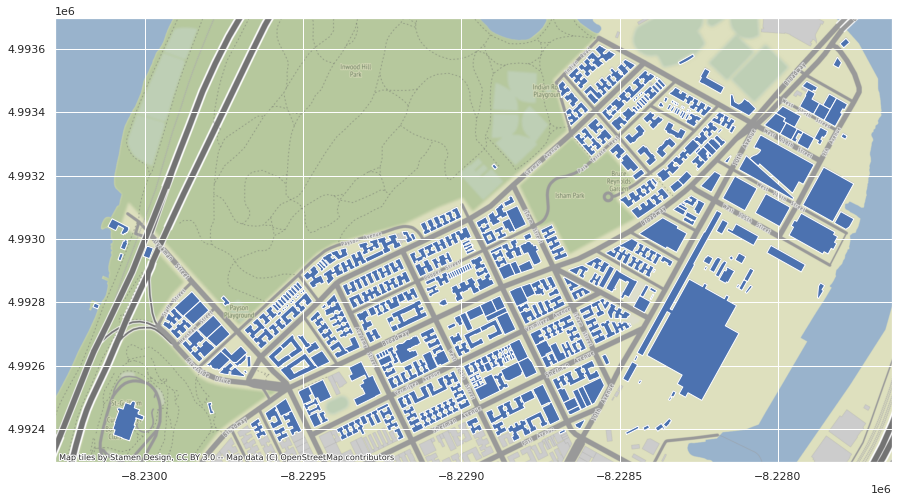

In [ ]:
ax = geo_df[10:480].plot(figsize=(15, 15), alpha=1.0)
#low index numbers (near 0) reference to northen parts of manhattan
cx.add_basemap(ax)

Randomly chosen geometric shape from the dataframe.

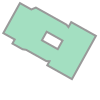

In [ ]:
geo_df['geometry'][np.random.randint(0,geo_df.shape[0])]

##Finding the centers of city blocks
Let's identify to which block does each bbl belong to and add this info to the geo dataframe.

In [ ]:
geo_df['block'] = ""
for index, row in geo_df.iterrows():
  geo_df['block'].iloc._setitem_with_indexer(index, int(str(row.base_bbl)[2:6]));
clear_output()

In [ ]:
geo_df.to_pickle('geo.pkl') #Save this data as it is very time consuming to generate it.

In [ ]:
#Load data
#df_ = pd.read_pickle('geo.pkl')
#geo_df = gpd.GeoDataFrame(df_,geometry='geometry')
#del df_

In [ ]:
geo_df.head(3)

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude,block
0,1022552000,23.30690696,1940.0,131.0,"MULTIPOLYGON (((-8229171.645 4994128.928, -822...",40.8764,-73.9239,2255
1,1022552000,17.4524275,NaN,137.0,"MULTIPOLYGON (((-8229202.303 4994100.885, -822...",40.8763,-73.9242,2255
2,1022552000,32,1940.0,149.0,"MULTIPOLYGON (((-8229214.133 4994079.842, -822...",40.876,-73.9244,2255


Using all the buildings that are located in one block, the center (lat,long,x,y) of such block is recorded and how many buildings it conatins and the total area these cover.

(These can be composed of more than one real block as some blocks were partitoned during the development of New York City).

In [ ]:
inProj = Proj('epsg:4326')
outProj = Proj('epsg:3857')

the_blocks = geo_df.block.unique()
the_blocks = [i for i in the_blocks if i != '']
network_df = pd.DataFrame(columns = ['block','latitude','longitude','number_of_buildings','x','y','total_area'],index=range(len(the_blocks)))
i = 0
for blockID in the_blocks:

  lista = geo_df.index[geo_df['block'] == blockID].tolist()
  lat_ = 0
  long_ = 0
  area = 0
  for index in lista:
    lat_ = lat_ + geo_df['latitude'].iloc[index]
    long_ = long_ + geo_df['longitude'].iloc[index]
    area = area + geo_df['geometry'].iloc[index].area

  number_of_buildings = len(lista)
  lat_ = lat_ / number_of_buildings
  long_ = long_ / number_of_buildings

  x, y = transform(inProj,outProj,lat_,long_)
  network_df['block'].iloc._setitem_with_indexer(i, blockID)
  network_df['latitude'].iloc._setitem_with_indexer(i, lat_)
  network_df['longitude'].iloc._setitem_with_indexer(i, long_)
  network_df['number_of_buildings'].iloc._setitem_with_indexer(i, number_of_buildings)
  network_df['x'].iloc._setitem_with_indexer(i, x)
  network_df['y'].iloc._setitem_with_indexer(i, y)
  network_df['total_area'].iloc._setitem_with_indexer(i, area)
  i = i + 1

clear_output()

Use the latitude and longitude to generate a GeoDataFrame Point

In [ ]:
network_df = gpd.GeoDataFrame(network_df, geometry=gpd.points_from_xy(network_df.x, network_df.y, crs="epsg:3857"))

This is a visualization of how the dataframe for city block locations looks like.

In [ ]:
network_df.head(3)

,block,latitude,longitude,number_of_buildings,x,y,total_area,geometry
0,2255,40.8735,-73.9233,7,-8.2291e+06,4.9937e+06,1885.47,POINT (-8229101.963 4993695.525)
1,2244,40.873,-73.9162,8,-8.22831e+06,4.99363e+06,28837.6,POINT (-8228308.234 4993629.188)
2,2215,40.872,-73.912,7,-8.22785e+06,4.99347e+06,9915.14,POINT (-8227845.067 4993474.344)


Lets save this information

In [ ]:
network_df.to_pickle('blocks.pkl') #Save this data as it is very time consuming to generate it.

In [ ]:
#Load data
#df_ = pd.read_pickle('blocks.pkl')
#network_df = gpd.GeoDataFrame(df_,geometry='geometry')
#del df_

###Graphing function for geometric data
Creation of a function to faciliate the graphing of buildings (polygons), centers of buildings (points) and as we will see below shortest distance between blocks (lines).

In [ ]:
def makeLayeredMap(*args):
    """This function accepts an arbitrary number of geodataframes, plots them on top of a Contextily basemap.
    Output: Saved file and layered map for display."""

    # Convert the CRS for all layers to EPSG3857 to match Contextily
    args = list(map(lambda x: x.to_crs(epsg=3857), args))
    # Create figure
    fig, ax = plt.subplots(1, figsize=(15, 15))
    #Set aspect to equal
    ax.set_aspect('equal')

    # PLOTTING: Specify layers to plot how to format each layer (colours, transparency, etc.):
    # Layer 1:
    args[0].boundary.plot(ax=ax, color='blue', alpha=0.3, zorder=1)

    if len(args) > 1:
      # Layer 2:
      if 'color' in args[1].columns:
        args[1].plot(ax=ax, color=args[1]['color'], alpha=0.65, zorder=2, markersize=50)
      else:
        args[1].plot(ax=ax, color='red', alpha=0.65, zorder=2, markersize=100)

    if len(args) > 2:
      # Layer 3:
      args[2].plot(ax=ax, color=args[2]['color'], alpha=1.0, zorder=3)

    # Contextily basemap:
    #cx.add_basemap(ax, source=cx.providers.CartoDB.Positron)
    cx.add_basemap(ax)
    # Turn off axis
    ax.axis('off')
    # Save as file
    fig.savefig('layered_map.png', dpi=300) #Comment out or delete if you don't want a PNG image saved
    layered_map = plt.show()
    return(layered_map)

Buildins in the dowtown area of manhattan each with their respective center of the block.

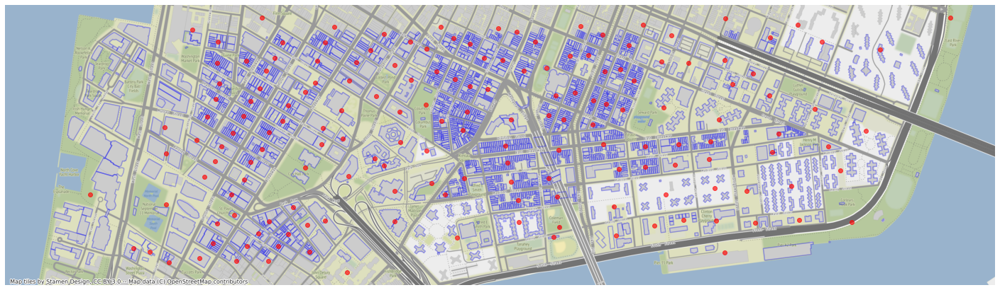

In [ ]:
start_bbl = 42380
finish_bbl = 44380
lista = [(network_df['block'] == i).idxmax() for i in geo_df[start_bbl:finish_bbl].block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]
makeLayeredMap(geo_df[start_bbl:finish_bbl],network_df.iloc[lista])

##Creating the city block network
Create a function to calculate the distance between two GPS locations.

In [ ]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance in kilometers between two points
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    return asin(sqrt(a)) * 12742 # Radius of earth in kilometers times c*2*r

Find all the distances between a block and all the other blocks in a vecinity of a 330 meter radius. Rats are known to not travel more than 182 meters from their nest when all their life condtions are no in a state of danger. Here we are assuming that if the their nest is under threat or wiped out rats will travel a much farther distance so this number was chosen to represent something under twice of a normal traveling distance.

In [ ]:
l, w = network_df.shape
AM = np.zeros((l,l))
skip1 = 0
for i in range(0,l):
  for j in range(i,l):
    if i!=j:
      D = haversine(network_df['longitude'][i],network_df['latitude'][i],network_df['longitude'][j],network_df['latitude'][j])
      if D < 0.330: #D < 0.182:
        AM[i,j]=D
        AM[j,i]=D
        skip1 = skip1 + 1
        if skip1 > 20:
          j = l - 1
          skip1 = 0

This allows the creation of an adjacency matrix for the connectivity between blocks.

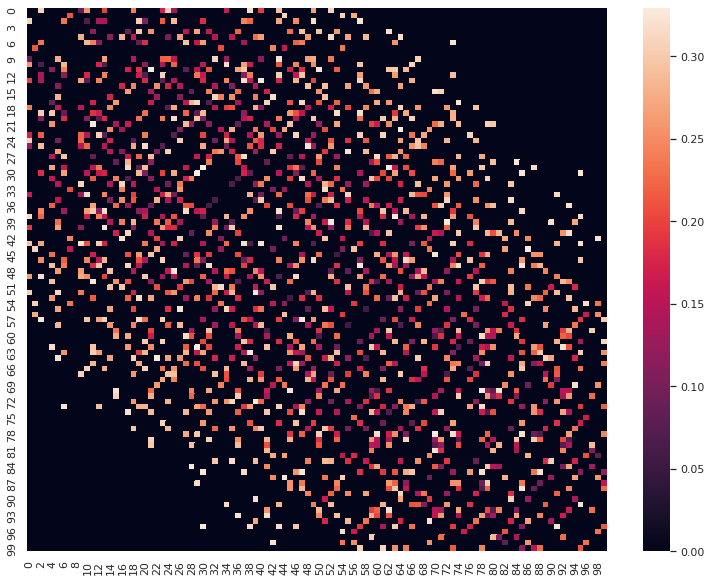

In [ ]:
fig, ax = plt.subplots(figsize=(13,10))
ax = sns.heatmap(AM[1700:1800,1700:1800])

With the above matrix it is possible to create a list of lines represting the shortest distance between buildings, to be used for graphical purposes.

In [ ]:
edges_df = gpd.GeoDataFrame(columns = ['id','start_block','end_block','start_x','start_y','end_x','end_y','length','geometry'],index=range(np.count_nonzero(AM)),crs='epsg:3857')

k = 0
for i in range(0,l):
  for j in range(0,l):
    if AM[i,j] > 0:
      max, min = np.max([network_df['block'][i],network_df['block'][j]]), np.min([network_df['block'][i],network_df['block'][j]])
      edges_df['id'].iloc._setitem_with_indexer(k, str(max)+'-'+str(min))
      edges_df['start_block'].iloc._setitem_with_indexer(k, network_df['block'][i])
      edges_df['end_block'].iloc._setitem_with_indexer(k, network_df['block'][j])
      edges_df['start_x'].iloc._setitem_with_indexer(k, network_df['x'][i])
      edges_df['start_y'].iloc._setitem_with_indexer(k, network_df['y'][i])
      edges_df['end_x'].iloc._setitem_with_indexer(k, network_df['x'][j])
      edges_df['end_y'].iloc._setitem_with_indexer(k, network_df['y'][j])
      edges_df['length'].iloc._setitem_with_indexer(k, AM[i,j])
      edges_df['geometry'].iloc._setitem_with_indexer(k, LineString([Point(network_df['x'][i], network_df['y'][i]), Point(network_df['x'][j], network_df['y'][j])]))
      k = k + 1

edges_df.set_geometry('geometry')
clear_output()
edges_df[1:4]

,id,start_block,end_block,start_x,start_y,end_x,end_y,length,geometry
1,2244-2243,2244,2243,-8.22831e+06,4.99363e+06,-8.22838e+06,4.99334e+06,0.22319,"LINESTRING (-8228308.234 4993629.188, -8228381..."
2,2215-2214,2215,2214,-8.22785e+06,4.99347e+06,-8.22794e+06,4.99334e+06,0.123503,"LINESTRING (-8227845.067 4993474.344, -8227942..."
3,2215-2197,2215,2197,-8.22785e+06,4.99347e+06,-8.22781e+06,4.99317e+06,0.228532,"LINESTRING (-8227845.067 4993474.344, -8227807..."


We only keep the 14 shortest distances between the center of blocks.

In [ ]:
to_keep_list = []
for m in range(0,l):
      for index_1, row_1 in edges_df[edges_df['start_block'] == network_df['block'].iloc[m]].sort_values('length')[0:14].iterrows():
              to_keep_list.append(row_1['id'])

In [ ]:
edges_df = edges_df[edges_df.id.isin(to_keep_list)]
edges_df = edges_df.reset_index(drop=True)
edges_df['color'] = '#000000'
del to_keep_list

It can be seen that there are too many lines emanating from the center of a block with many nearly overlapping.

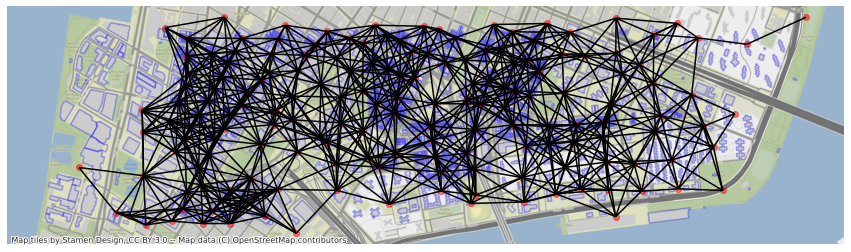

In [ ]:
start_bbl = 42380
finish_bbl = 44380
lista = [(network_df['block'] == i).idxmax() for i in geo_df[start_bbl:finish_bbl].block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]

edges = []
for i in range(0,len(lista)):
 for j in range(i+1,len(lista)):
   idx = ((edges_df['start_block'] == network_df['block'].iloc[lista[i]]) & (edges_df['end_block'] == network_df['block'].iloc[lista[j]])).idxmax()
   if idx>0:
    edges.append(idx)

makeLayeredMap(geo_df[start_bbl:finish_bbl],network_df.iloc[lista],edges_df.iloc[edges])

Create a function to calculate the angle between two lines with a common point.

In [ ]:
def dot(vA, vB):
    return vA[0]*vB[0]+vA[1]*vB[1]
def ang(Astrat_x,Astart_y,Aend_x,Aend_y,Bstrat_x,Bstart_y,Bend_x,Bend_y):
    # Get nicer vector form
    vA = [(Astrat_x-Aend_x), (Astart_y-Aend_y)]
    vB = [(Bstrat_x-Bend_x), (Bstart_y-Bend_y)]
    # Get dot prod
    dot_prod = dot(vA, vB)
    # Get magnitudes
    magA = dot(vA, vA)**0.5
    magB = dot(vB, vB)**0.5
    # Get cosine value
    cos_ = dot_prod/magA/magB
    # Get angle in radians and then convert to degrees
    angle = acos(dot_prod/magB/magA)
    # Basically doing angle <- angle mod 360
    ang_deg = degrees(angle)%360

    if ang_deg-180>=0:
        # As in if statement
        return 360 - ang_deg
    else:
        return ang_deg

Remove lines that are less the 22.5 degrees from any other line sharing a commun point.

In [ ]:
to_eliminate_list = []
for m in range(0,l):
      z = 1
      for index_1, row_1 in edges_df[edges_df['start_block'] == network_df['block'].iloc[m]].sort_values('length').iterrows():

        for g in to_eliminate_list:
          if g == row_1['id']:
            z = z + 1
            continue
        for index_2, row_2 in edges_df[edges_df['start_block'] == network_df['block'].iloc[m]].sort_values('length')[z:].iterrows():
            angle = ang(row_1['start_x'],row_1['start_y'],row_1['end_x'],row_1['end_y'],row_2['start_x'],row_2['start_y'],row_2['end_x'],row_2['end_y'])
            if angle < 22.5 :
              to_eliminate_list.append(row_2['id'])

        z = z + 1

In [ ]:
edges_df = edges_df[~edges_df.id.isin(to_eliminate_list)]
edges_df = edges_df.reset_index(drop=True)
del to_eliminate_list

In [ ]:
edges_df.head()

,id,start_block,end_block,start_x,start_y,end_x,end_y,length,geometry
0,2250-2244,2244,2250,-8.22831e+06,4.99363e+06,-8.22859e+06,4.99348e+06,0.237672,"LINESTRING (-8228308.234 4993629.188, -8228587..."
1,2244-2243,2244,2243,-8.22831e+06,4.99363e+06,-8.22838e+06,4.99334e+06,0.22319,"LINESTRING (-8228308.234 4993629.188, -8228381..."
2,2215-2214,2215,2214,-8.22785e+06,4.99347e+06,-8.22794e+06,4.99334e+06,0.123503,"LINESTRING (-8227845.067 4993474.344, -8227942..."
3,2215-2197,2215,2197,-8.22785e+06,4.99347e+06,-8.22781e+06,4.99317e+06,0.228532,"LINESTRING (-8227845.067 4993474.344, -8227807..."
4,2250-2244,2250,2244,-8.22859e+06,4.99348e+06,-8.22831e+06,4.99363e+06,0.237672,"LINESTRING (-8228587.006 4993483.245, -8228308..."


In [ ]:
to_keep_list = []
l, w = network_df.shape
for m in range(0,l):
      for index_1, row_1 in edges_df[edges_df['start_block'] == network_df['block'].iloc[m]].sort_values('length')[0:8].iterrows():
              #for g in to_keep_list
              to_keep_list.append(row_1['id'])

In [ ]:
edges_df = edges_df[edges_df.id.isin(to_keep_list)]
edges_df = edges_df.reset_index(drop=True)
edges_df['color'] = '#000000'
edges_df.to_pickle('edges.pkl') #Save this data as it is very time consuming to generate it.
del to_keep_list

In [ ]:
#Load data
#df_ = pd.read_pickle('edges.pkl')
#edges_df = gpd.GeoDataFrame(df_,geometry='geometry')
#del df_

It can be seen that all overlapping lines (less than 22.5 degrees apart) have been removed. This concludes with the creation of a network for future application.

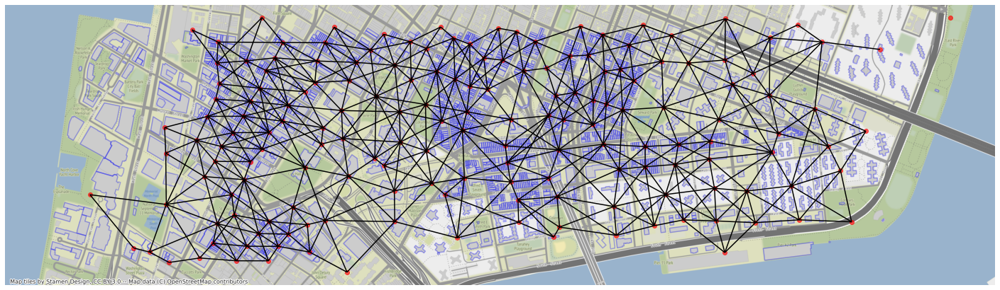

In [ ]:
start_bbl = 42380
finish_bbl = 44380

lista = [(network_df['block'] == i).idxmax() for i in geo_df[start_bbl:finish_bbl].block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]

edges = []
for i in range(0,len(lista)):
 for j in range(i+1,len(lista)):
   idx = ((edges_df['start_block'] == network_df['block'].iloc[lista[i]]) & (edges_df['end_block'] == network_df['block'].iloc[lista[j]])).idxmax()
   if idx>0:
    edges.append(idx)

makeLayeredMap(geo_df[start_bbl:finish_bbl],network_df.iloc[lista],edges_df.iloc[edges])

##Finding the **shortest routes** between blocks (A*)
The adjacency matrix is recalculated.

In [ ]:
l, w = network_df.shape
AM = np.zeros((l,l))
skip1 = 0
for i in range(0,l):
  for index_1, row_1 in (edges_df[edges_df['start_block'] == network_df['block'].iloc[i]]).iterrows():
      j = (network_df['block'] == row_1.end_block ).idxmax()
      AM[i,j] = row_1.length #this matrix is organized by network_df which is orgnaized by lat and then long
      AM[j,i] = row_1.length

Notice it conatins less non zero values as before.

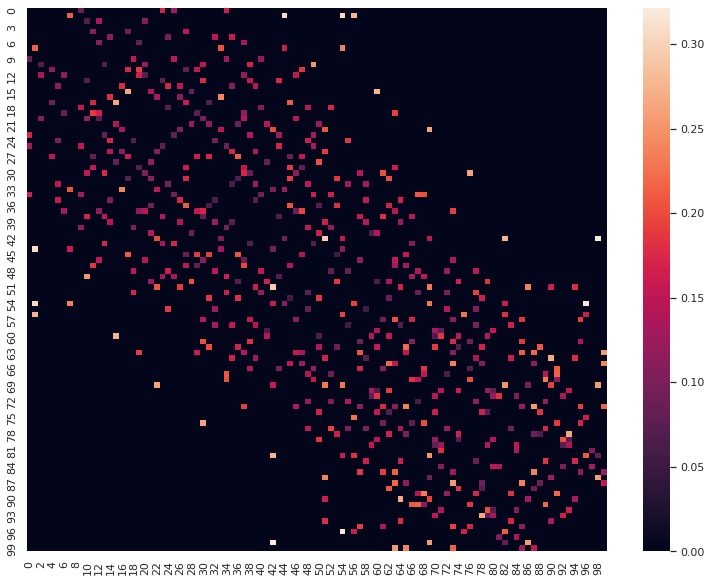

In [ ]:
fig, ax = plt.subplots(figsize=(13,10))
ax = sns.heatmap(AM[1700:1800,1700:1800])

The adjacency matrix is suppose to be symmetric. A quick inspection verifies this claim.

In [ ]:
AM[1751,1739] == AM[1739,1751]

True

Convert this adjacency matrix to a graph.

In [ ]:
G = networkx.convert_matrix.from_numpy_array(AM, parallel_edges=False, create_using=networkx.Graph)

Use the greater circles distance as an approximation of the distance between two GPS locations to be used as a heuristic.

In [ ]:
def linear_distance(a,b): #used as heuristic for A-star serach algorithim
  return haversine(network_df['longitude'][a],network_df['latitude'][a],network_df['longitude'][b],network_df['latitude'][b])

Lets test the shortest path chosen between two blocks.

In [ ]:
S = 1709 #starting block
T = lista[np.random.randint(0,len(lista)-1)] #random ending block

Lets inspect the time it takes to conduct a search on average without a heuristic function used as an approximator.

In [ ]:
size = 1000
tiempos = np.zeros((size))
for i in range(0,size):
  startTime = datetime.now()
  path = networkx.algorithms.shortest_paths.astar.astar_path(G,S,T)
  d = (datetime.now() - startTime)
  tiempos[i] = d.microseconds

mean_outwith, std_outwith = tiempos.mean(), tiempos.std()
print ("The mean time for A* WITHOUT a heauristic function is "+str(mean_outwith)+" microseconds with a std of "+str(std_outwith)+" microseconds.")

The mean time for A* WITHOUT a heauristic function is 4347.765 microseconds with a std of 451.65901051014134 microseconds.


And the time it takes to do the same search on average but with using an approximator for distance.

In [ ]:
size = 1000
tiempos = np.zeros((size))
for i in range(0,size):
  startTime = datetime.now()
  path = networkx.algorithms.shortest_paths.astar.astar_path(G,S,T,heuristic=linear_distance)
  d = (datetime.now() - startTime)
  tiempos[i] = d.microseconds

mean_with, std_with = tiempos.mean(), tiempos.std()
print ("The mean time for A* WITH a heauristic function is "+str(mean_with)+" microseconds with a std of "+str(std_with)+" microseconds.")

The mean time for A* WITH a heauristic function is 2988.074 microseconds with a std of 297.67974490045503 microseconds.


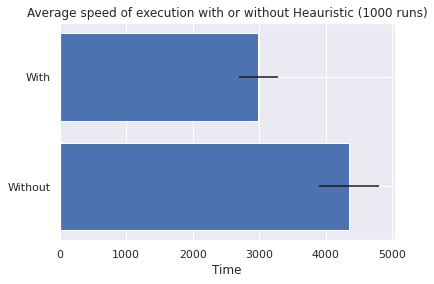

In [ ]:
# Example data
types = ('With', 'Without')
y_pos = np.arange(len(types))
performance = [mean_with, mean_outwith]
error = [std_with, std_outwith]

fig, ax = plt.subplots()
hbars = ax.barh(y_pos, performance, xerr=error, align='center')
ax.set_yticks(y_pos)
ax.set_yticklabels(types)
ax.invert_yaxis()  #labels read top-to-bottom
ax.set_xlabel('Time')
ax.set_title('Average speed of execution with or without Heauristic (1000 runs)')

plt.show()

Re-color the edges to show the path chosen by the A* algorithm.

In [ ]:
edges_df['color'] = '#000000' #color all blocks black before coloring those in the set of the shortest path.
for i in range(0,len(path)-1):
  idx = ((edges_df['start_block'] == network_df['block'].iloc[path[i]]) & (edges_df['end_block'] == network_df['block'].iloc[path[i+1]])).idxmax()
  edges_df['color'].iloc._setitem_with_indexer(idx, '#FF0000')
  idx = ((edges_df['start_block'] == network_df['block'].iloc[path[i+1]]) & (edges_df['end_block'] == network_df['block'].iloc[path[i]])).idxmax()
  edges_df['color'].iloc._setitem_with_indexer(idx, '#FF0000')
clear_output()

The red path is the one chosen by the A* algorithm

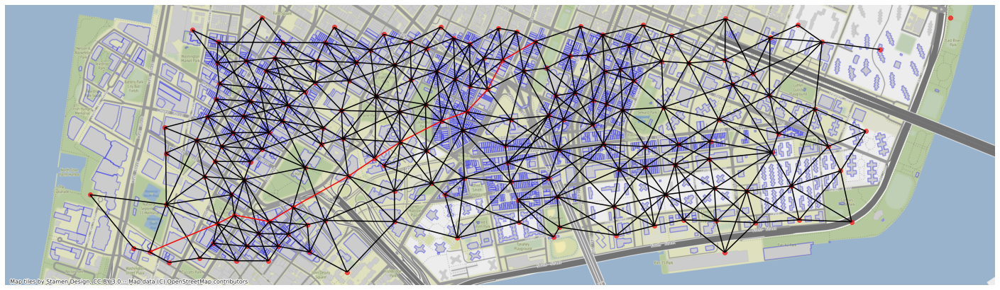

In [ ]:
makeLayeredMap(geo_df[start_bbl:finish_bbl],network_df.iloc[lista],edges_df.iloc[edges])

#Exploring rat inspections and **identifying clusters**
Get the latest report for all the buildings in the island of Manhattan.

Reorganize report dataframe in decending time order and extract latest report.

In [ ]:
df_reports = df_reports.sort_values(by='INSPECTION_DATE',ascending=False)
df_reports = df_reports.reset_index(drop=True)

In [ ]:
dictionary_list = []
unique_BBL = geo_df.base_bbl.unique()

for row in unique_BBL:
  idx = (df_reports['BBL'] == row).idxmax()

  if (df_reports['BBL'].iloc[idx] == row):
    dictionary_list.append(df_reports.iloc[idx])

df_latest_report = pd.DataFrame(dictionary_list)
del dictionary_list

These are the types of reporting.

In [ ]:
df_latest_report.to_pickle('df_latest_report.pkl') #Save this data as it is very time consuming to generate it.
df_latest_report.RESULT.unique()

array(['Passed', 'Failed for Other R', 'Monitoring visit', 'Bait applied',
       'Rat Activity', 'Stoppage done'], dtype=object)

In [ ]:
#Load data
#df_ = pd.read_pickle('df_latest_report.pkl')
#df_latest_report = pd.DataFrame(df_)
#del df_

Add to the GeoDataFrame a color column used to indicate the current status of the building.


In [ ]:
geo_df['color_report'] = '#000000' #Initialized as color black. (There appears to be some structures that never get reported on).
geo_df['status'] = '_blank_'
geo_df['inspection_date'] = pd.NaT
unique_BBL = geo_df.base_bbl.unique()

for row in unique_BBL:
  hold = df_latest_report.loc[ df_latest_report['BBL'] == row ].RESULT
  date = df_latest_report.loc[ df_latest_report['BBL'] == row ].INSPECTION_DATE
  if hold.empty:
    result = 'No result'
    date = pd.NaT
  else:
    result = hold.values[0]
    date = date.values[0]

  geo_df.loc[geo_df.base_bbl == row, 'inspection_date'] = date

  if result=='Passed':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#01DF3A' #GREEN: passed
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Passed'
  elif result=='Rat Activity':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#FF0000' #RED: rat activity
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Rat Activity'
  elif result=='Failed for Other R':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#8000FF' #PURPULE: failed for other reason
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Failed for Other Reasons'
  elif result=='Bait applied':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#FAAC58' #ORANGE: bait applied
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Bait applied'
  elif result=='Monitoring visit':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#F7FE2E' #YELLOW: monitoring visit
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Monitoring visit'
  elif result=='Stoppage done':
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#F781F3' #PINK: stoppage done
    geo_df.loc[geo_df.base_bbl == row, 'status'] = 'Stoppage done'
  else:
    geo_df.loc[geo_df.base_bbl == row, 'color_report'] = '#000000' #BLACK: no info
    geo_df.loc[geo_df.base_bbl == row, 'status'] = '_blank_'

Lets add the area of the building to the geo dataframe

In [ ]:
geo_df['area'] = geo_df['geometry'].to_crs(epsg=4326).area*(10**10)*10.7639
clear_output()

In [ ]:
geo_df[100:102]

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude,block,color_report,status,nearest_park,area_of_park,GPS_point,z_measure,buildings_area,inspection_date,area
100,1022430090,68.77,1924.0,82.0,"MULTIPOLYGON (((-8228591.464 4993298.548, -822...",40.8707,-73.9187,2243,#FF0000,Rat Activity,0.000138,1.129575e-06,POINT (-73.91874 40.87066),0.008185,734.985992,2019-12-10 15:48:30,4827.657374
101,1022430261,10.18486032,1953.0,46.0,"MULTIPOLYGON (((-8228242.940 4993284.268, -822...",40.8706,-73.9157,2243,#01DF3A,Passed,0.001187,1.071291e-08,POINT (-73.91565 40.87064),0.000009,149.552882,2019-11-22 12:16:53,982.318343


Now it can be seen which buildings are infected or not.

In [ ]:
start_bbl = 42380
finish_bbl = 44380
m = folium.Map(location=[40.714877, -73.997499],zoom_start=15.2, tiles='CartoDB positron');
for _, r in geo_df[start_bbl:finish_bbl].to_crs(epsg=4326).iterrows():
    # Without simplifying the representation of each borough, the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.00001)
    geo_j = sim_geo.to_json()
    fillColor = r['color_report']
    color = r['color_report']
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x, fillColor=fillColor, color=color: {
            "fillColor": fillColor,
            "color": color,'weight' : 1,'fillOpacity' : 0.5})
    folium.Popup(r['status']).add_to(geo_j)
    geo_j.add_to(m)
fig = folium.Figure(width=1200, height=400)
fig.add_child(m)

Histogram of the latest inspection report results.

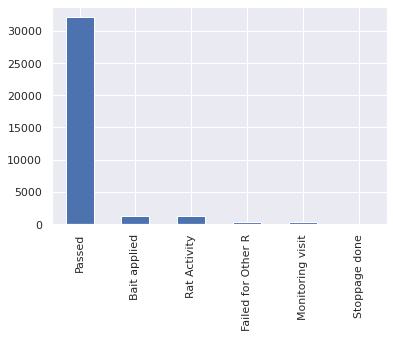

In [ ]:
df_latest_report.RESULT.value_counts().plot(kind='bar')

Lets get the CRS center for each building

In [ ]:
geo_df['x'] = geo_df['geometry'].centroid.x
geo_df['y'] = geo_df['geometry'].centroid.y

Lets select those buildings with Rat Activity to cluster them into communities

###Find distance based Hierarchical clustering.
Lets use a distance vs. k-clusters graph to identify optimal partitioning parameters.

In [ ]:
df_ac_0 = geo_df[start_bbl:finish_bbl]; df_ac_0 = df_ac_0[df_ac_0.color_report == '#FF0000'];
df_ac_1 = geo_df[start_bbl:finish_bbl]; df_ac_1 = df_ac_1[df_ac_1.color_report == '#FF0000'];
df_ac_2 = geo_df[start_bbl:finish_bbl]; df_ac_2 = df_ac_2[df_ac_2.color_report == '#FF0000'];
#df_groups = df_groups[(df_groups.color_report == '#FF0000') | (df_groups.color_report == '#8000FF') | (df_groups.color_report == '#F7FE2E')]

Lets construct a function to calculate minkowski distance between two points for buidlings.


In [ ]:
def mink (df,name_1,name_2,P):
  L = pd.DataFrame.to_numpy(df[[name_1,name_2]])
  distances = np.zeros((L.shape[0],L.shape[0]))
  for i in range(0,L.shape[0]):
    for j in range(i,L.shape[0]):
      distances[j,i] = distances[i,j] = minkowski(L[i],L[j],P)
  return distances

In [ ]:
n = 450
m = (n - 10)/5
elbow_ac = np.zeros((4,int(m)))
affinities = ['euclidean','manhattan','precomputed']
ps = [3,4]
k = 0
link = 'single'
for af in affinities:
  j = 0
  if af != 'precomputed':
    for i in range(10,n,5):
      groups = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=i,linkage=link,affinity=af).fit(pd.DataFrame.to_numpy(df_ac_0[['x','y']]))
      elbow_ac[k,j] = np.unique(groups.labels_)[-1]
      j = j + 1
  else:
    for p in ps:
      j = 0
      distance_matrix = mink(df_ac_0,'x','y',p)
      for i in range(10,n,5):
        groups = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=i,linkage=link,affinity='precomputed').fit(distance_matrix)
        elbow_ac[k,j] = np.unique(groups.labels_)[-1]
        j = j + 1
      k = k + 1
  k = k + 1

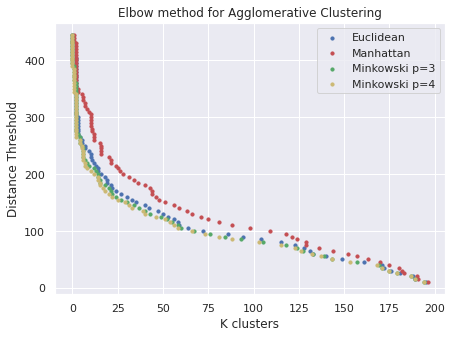

In [ ]:
fig = plt.figure(figsize=(7, 5))
ax1 = fig.add_subplot(111)

ax1.scatter(elbow_ac[0,:], range(10,n,5), s=10, c='b', marker="o", label='Euclidean')
ax1.scatter(elbow_ac[1,:], range(10,n,5), s=10, c='r', marker="o", label='Manhattan')
ax1.scatter(elbow_ac[2,:], range(10,n,5), s=10, c='g', marker="o", label='Minkowski p=3')
ax1.scatter(elbow_ac[3,:], range(10,n,5), s=10, c='y', marker="o", label='Minkowski p=4')
plt.legend(loc='upper right');
plt.title('Elbow method for Agglomerative Clustering');
plt.xlabel('K clusters')
plt.ylabel('Distance Threshold')
plt.show()

For the **Euclidean** and **Minkowski** method a good elbow value for the distance threshold is ~110.

For the **Manhattan** method a good elbow value for the distance threshold is ~140.

In [ ]:
ac_0 = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=100,linkage='single',affinity='precomputed').fit(mink(df_ac_0,'x','y',4))
ac_1 = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=105,linkage='single',affinity='euclidean').fit(df_ac_1[['x','y']])
ac_2 = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=140,linkage='single',affinity='manhattan').fit(df_ac_2[['x','y']])

Color code clusters with unique colors.

In [ ]:
def random_color():
  return np.random.randint(0,255)

In [ ]:
to_plot = [ac_0,ac_1,ac_2]

for z in range(0,3):
  df_ = globals()["df_ac_" + str(z)]
  group = to_plot[z]
  color_codes = [None]*np.unique(group.labels_)[-1]

  for i in range(0,np.unique(group.labels_)[-1]):
    color_codes[i] = ('#%02X%02X%02X' % (random_color(),random_color(),random_color()))

  for i in range(0,group.labels_.shape[0]):
    f = color_codes[group.labels_[i]-1]
    df_['color_report'].iloc._setitem_with_indexer(i, f)

  globals()["df_ac_" + str(z)] = df_
del df_
clear_output()

Below can be seen the best clustering for each method with their respective parameter value.

In [ ]:
m = folium.Map(location=[40.71450398929399, -73.99350441019716],zoom_start=15, tiles=None)
folium.TileLayer('CartoDB positron',name="Agglomerative Clustering",control=True).add_to(m)


boolean = [True,False,False]
names = ['Minwoski P=4','Euclidean','Manhattan']
for z in range(0,3):
  globals()["feature_" + str(z)] = folium.FeatureGroup(name=names[z],show=boolean[z],overlay=True,control=True)
  for _, r in globals()["df_ac_" + str(z)].to_crs(epsg=4326).iterrows():
    # Without simplifying the representation of each borough, the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.00001)
    geo_j = sim_geo.to_json()
    fillColor = r['color_report']
    color = r['color_report']
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x, fillColor=fillColor, color=color: {
            "fillColor": fillColor,
            "color": color,'weight' : 1,'fillOpacity' : 0.5})
    folium.Popup(r['status']).add_to(geo_j)
    geo_j.add_to(globals()["feature_" + str(z)])
  globals()["feature_" + str(z)].add_to(m)
folium.LayerControl(collapsed=False,).add_to(m)
fig = folium.Figure(width=1200, height=500)
fig.add_child(m)

This clustering method works great ✅

###Density-Based Spatial Clustering
Lets look at another type of clustering technique Density-Based Spatial Clustering of Applications with Noise. Lets use a distance vs. k-clusters graph to identify optimal partitioning parameters. This basically reproduces the same results as the one above (agglomerative clustering).

In [ ]:
df_dbscan_0 = geo_df[start_bbl:finish_bbl]; df_dbscan_0 = df_dbscan_0[df_dbscan_0.color_report == '#FF0000'];
df_dbscan_1 = geo_df[start_bbl:finish_bbl]; df_dbscan_1 = df_dbscan_1[df_dbscan_1.color_report == '#FF0000'];
df_dbscan_2 = geo_df[start_bbl:finish_bbl]; df_dbscan_2 = df_dbscan_2[df_dbscan_2.color_report == '#FF0000'];

In [ ]:
n = 450
m = (n - 10)/5
elbow_dbscan = np.zeros((3,int(m)))
affinities = ['euclidean','manhattan','precomputed']
ps = [4]
k = 0
for af in affinities:
  j = 0
  if af != 'precomputed':
    for i in range(10,n,5):
      groups = skl.cluster.DBSCAN(eps=i, min_samples=2, metric=af).fit(pd.DataFrame.to_numpy(df_dbscan_0[['x','y']]))
      count = 0
      for x in range(0,groups.labels_.shape[0]):
        if groups.labels_[x] == -1:
          count = count + 1
      elbow_dbscan[k,j] = np.unique(groups.labels_+1)[-1] + count -1
      j = j + 1
  else:
    for p in ps:
      j = 0
      distance_matrix = mink(df_dbscan_0,'x','y',p)
      for i in range(10,n,5):
        groups = skl.cluster.DBSCAN(eps=i, min_samples=2, metric='precomputed').fit(distance_matrix)
        count = 0
        for x in range(0,groups.labels_.shape[0]):
          if groups.labels_[x] == -1:
            count = count + 1
        elbow_dbscan[k,j] = np.unique(groups.labels_+1)[-1] + count -1
        j = j + 1
      k = k + 1
  k = k + 1

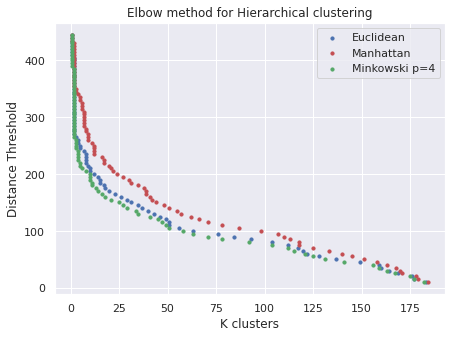

In [ ]:
fig = plt.figure(figsize=(7, 5))
ax1 = fig.add_subplot(111)

ax1.scatter(elbow_dbscan[0,:], range(10,n,5), s=10, c='b', marker="o", label='Euclidean')
ax1.scatter(elbow_dbscan[1,:], range(10,n,5), s=10, c='r', marker="o", label='Manhattan')
ax1.scatter(elbow_dbscan[2,:], range(10,n,5), s=10, c='g', marker="o", label='Minkowski p=4')
plt.legend(loc='upper right');
plt.title('Elbow method for Hierarchical clustering');
plt.xlabel('K clusters')
plt.ylabel('Distance Threshold')
plt.show()

In [ ]:
dbscan_0 = skl.cluster.DBSCAN(eps=105, min_samples=2, metric=af).fit(mink(df_dbscan_0,'x','y',4))
dbscan_1 = skl.cluster.DBSCAN(eps=110, min_samples=2, metric='euclidean').fit(pd.DataFrame.to_numpy(df_dbscan_1[['x','y']]))
dbscan_2 = skl.cluster.DBSCAN(eps=170, min_samples=2, metric='manhattan').fit(pd.DataFrame.to_numpy(df_dbscan_2[['x','y']]))

In [ ]:
to_plot = [dbscan_0,dbscan_1,dbscan_2]

for z in range(0,3):
  df_ = globals()["df_dbscan_" + str(z)]
  group = to_plot[z]
  color_codes = [None]*np.unique(group.labels_)[-1]

  for i in range(0,np.unique(group.labels_)[-1]):
    color_codes[i] = ('#%02X%02X%02X' % (random_color(),random_color(),random_color()))

  for i in range(0,group.labels_.shape[0]):
    if group.labels_[i] == -1 :
      df_['color_report'].iloc._setitem_with_indexer(i, '#000000')
  else:
    f = color_codes[group.labels_[i]-1]
    df_['color_report'].iloc._setitem_with_indexer(i, f)

  globals()["df_dbscan_" + str(z)] = df_
del df_
clear_output()

In [ ]:
m = folium.Map(location=[40.71450398929399, -73.99350441019716],zoom_start=15, tiles=None)
folium.TileLayer('CartoDB positron',name="DBSCAN",control=True).add_to(m)


boolean = [True,False,False]
names = ['Minwoski P=4','Euclidean','Manhattan']
for z in range(0,3):
  globals()["feature_" + str(z)] = folium.FeatureGroup(name=names[z],show=boolean[z],overlay=True,control=True)
  for _, r in globals()["df_dbscan_" + str(z)].to_crs(epsg=4326).iterrows():
    # Without simplifying the representation of each borough, the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.00001)
    geo_j = sim_geo.to_json()
    fillColor = r['color_report']
    color = r['color_report']
    geo_j = folium.GeoJson(data=geo_j, style_function=lambda x, fillColor=fillColor, color=color: {
            "fillColor": fillColor,
            "color": color,'weight' : 1,'fillOpacity' : 0.5})
    folium.Popup(r['status']).add_to(geo_j)
    geo_j.add_to(globals()["feature_" + str(z)])
  globals()["feature_" + str(z)].add_to(m)
folium.LayerControl(collapsed=False,).add_to(m)
fig = folium.Figure(width=1200, height=500)
fig.add_child(m)

All black buildings do not belong to the same cluster, they are in their own unique cluster.

Basically reproduces the same results of Agglometraive Clustering

###K-means
Lets analyze if Kmeans++ is a good way to identify clusters. Lets use a distance vs. k-clusters graph to identify optimal partitioning parameters.
Not a good method.❌

In [ ]:
df_km_0 = geo_df[start_bbl:finish_bbl]; df_km_0 = df_km_0[df_km_0.color_report == '#FF0000'];

In [ ]:
n = 180
elbow_km = np.zeros(int((n-10)/10))
j = 0
for i in range(10,n,10):
      groups = skl.cluster.KMeans(n_clusters=i,max_iter=1000).fit(pd.DataFrame.to_numpy(df_km_0[['x','y']]),pd.DataFrame.to_numpy(df_km_0[['area']]))
      elbow_km[j] = groups.inertia_
      j = j + 1

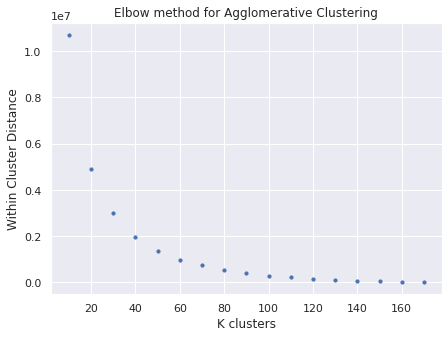

In [ ]:
fig = plt.figure(figsize=(7, 5))
ax2 = fig.add_subplot(111)

ax2.scatter(range(10,n,10), elbow_km[:],  s=10, c='b', marker="o")
plt.title('Elbow method for Agglomerative Clustering');
plt.xlabel('K clusters')
plt.ylabel('Within Cluster Distance')
plt.show()

In [ ]:
groups = skl.cluster.KMeans(n_clusters=100,max_iter=1000).fit(pd.DataFrame.to_numpy(df_km_0[['x','y']]),pd.DataFrame.to_numpy(df_km_0[['area']]))

In [ ]:
color_codes = [None]*np.unique(groups.labels_)[-1]
r = lambda: np.random.randint(0,255)
for i in range(0,np.unique(groups.labels_)[-1]):
  color_codes[i] = ('#%02X%02X%02X' % (r(),r(),r()))
for i in range(0,groups.labels_.shape[0]):
  f = color_codes[groups.labels_[i]-1]
  df_km_0['color_report'].iloc._setitem_with_indexer(i, f)
clear_output()

This is an uninformed partitioning of the infected buildings an generates some paritions where very nearby buildings can get placed into different clusters.  It also relies on random inital conditions produccing different results every run. Not the best way to go.

(-8239875.936397414, -8234631.029077776, 4969545.2623241125, 4970917.910201123)

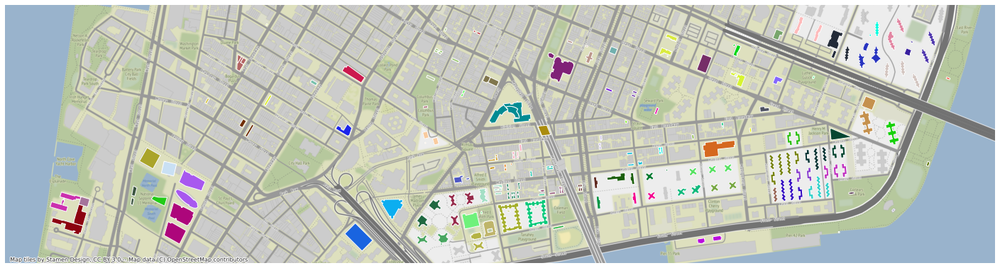

In [ ]:
ax = df_km_0.plot(figsize=(25, 25), alpha=1.0, color=df_km_0['color_report'])
cx.add_basemap(ax)
ax.axis('off')

##Regression
In the following session we use logitic regression on the availabe data to make predictions as to which building would be classified as being infected or not. The fields that are intially used are the year of construction, ground elevation (to sea level) of a construction, the building's area and the height of a building.

In [ ]:
geo_df['buildings_area'] = geo_df.geometry.area.astype(float)
regression_df = pd.DataFrame(geo_df[geo_df['status']!='Failed for Other R'])
regression_df = regression_df[regression_df['status']!='_blank_']
regression_df =  regression_df.drop(columns=['geometry', 'color_report','base_bbl','block'])
regression_df = regression_df.dropna()
regression_df['heightroof'] = pd.to_numeric(regression_df['heightroof'], downcast="float")

regression_df.loc[(regression_df.status == 'Passed'),'status'] = 0
regression_df.loc[(regression_df.status != 0),'status'] = 1
regression_df = regression_df.sort_values('status', ascending=True)
regression_df = regression_df.reset_index(drop=True)

As seen below the data is not separable with the mention fields above, this entails that the logitic regression will fail.

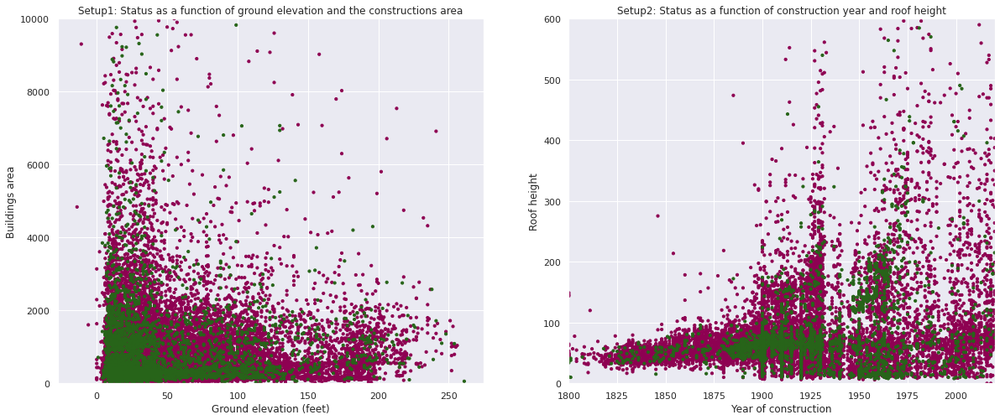

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2);
fig.set_figheight(8)
fig.set_figwidth(20)

ax1.scatter(regression_df['groundelev'], regression_df['buildings_area'], s=10, c=regression_df['status'], marker="o", cmap='PiYG');
ax1.set_title('Setup1: Status as a function of ground elevation and the constructions area');
ax1.set_ylim([0,10000])
ax1.set_ylabel('Buildings area');
ax1.set_xlabel('Ground elevation (feet)');

ax2.scatter(regression_df['cnstrct_yr'], regression_df['heightroof'], s=10, c=regression_df['status'], marker="o", cmap='PiYG');
ax2.set_title('Setup2: Status as a function of construction year and roof height');
ax2.set_ylim([0,600])
ax2.set_xlim([1800,2020])
ax2.set_xlabel('Year of construction');
ax2.set_ylabel('Roof height');

#green represent infected

A 3D visualization for construction year + buildings area + roof height

In [ ]:
mask = (regression_df['buildings_area'] < 10000)
df_ = regression_df[mask]
fig = px.scatter_3d(df_, x='cnstrct_yr', y='buildings_area', z='heightroof', color='status', size_max=0.5, opacity=0.1)
fig.show()

Using logistic regression the following decision boundaries are found.

Partiton the data into randomly selected 80% training and 20% test sets.

In [ ]:
infected = regression_df[regression_df['status'] == 1]
clean = regression_df[regression_df['status'] == 0]

infected_train, infected_test = train_test_split(infected[['cnstrct_yr', 'heightroof','groundelev','buildings_area','status']], test_size=0.2)
clean_train, clean_test = train_test_split(clean[['cnstrct_yr', 'heightroof','groundelev','buildings_area','status']], test_size=0.2)
train = infected_train.append(clean_train)
test = infected_test.append(clean_test)

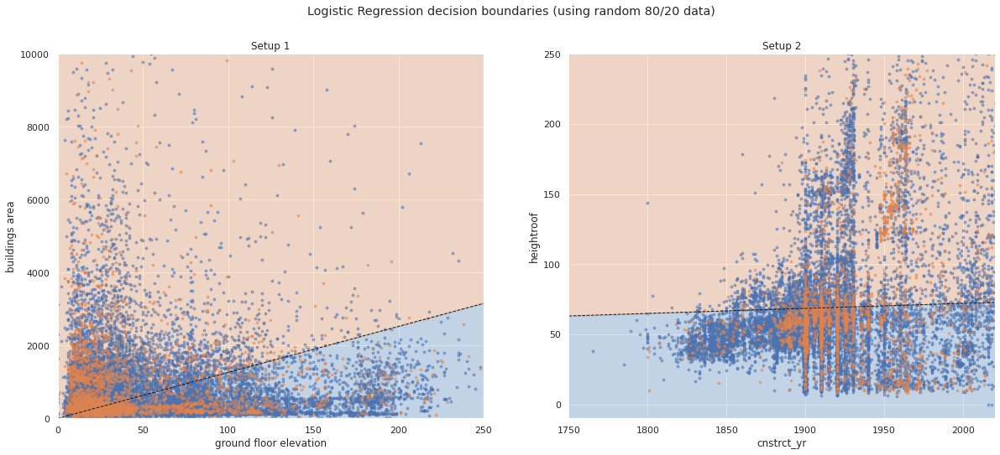

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2);
fig.set_figheight(8)
fig.set_figwidth(20)
clf2 = skl_linear.LogisticRegression(class_weight="balanced")
X = train[['cnstrct_yr', 'heightroof']].to_numpy().astype('float')
y = train['status'].to_numpy().astype('int')
clf2.fit(X,y)
# Retrieve the model parameters.
b = clf2.intercept_
w1, w2 = clf2.coef_.T
# Calculate the intercept and gradient of the decision boundary.
c = -b/w2
m = -w1/w2
# Plot the data and the classification with the decision boundary.
xmin, xmax = 1750,2020
ymin, ymax = -10,250
xd = np.array([xmin, xmax])
yd = m*xd + c
ax2.plot(xd, yd, 'k', lw=1, ls='--')
ax2.fill_between(xd, yd, ymin, color='tab:blue', alpha=0.2)
ax2.fill_between(xd, yd, ymax, color='tab:orange', alpha=0.2)
ax2.scatter(*X[y==0].T, s=8, alpha=0.5)
ax2.scatter(*X[y==1].T, s=8, alpha=0.5)
ax2.set_xlim(xmin, xmax)
ax2.set_ylim(ymin, ymax)
ax2.set_title('Setup 2')
ax2.set_ylabel('heightroof')
ax2.set_xlabel('cnstrct_yr')
clf1 = skl_linear.LogisticRegression(class_weight="balanced")
X = train[['groundelev', 'buildings_area']].to_numpy().astype('float')
y = train['status'].to_numpy().astype('int')
clf1.fit(X,y)
# Retrieve the model parameters.
b = clf1.intercept_
w1, w2 = clf1.coef_.T
# Calculate the intercept and gradient of the decision boundary.
c = -b/w2
m = -w1/w2
# Plot the data and the classification with the decision boundary.
xmin, xmax = 0,250
ymin, ymax = 0,10000
xd = np.array([xmin, xmax])
yd = m*xd + c
ax1.plot(xd, yd, 'k', lw=1, ls='--')
ax1.fill_between(xd, yd, ymin, color='tab:blue', alpha=0.2) # BLUE MEANS A BUILDING IS CLEAN
ax1.fill_between(xd, yd, ymax, color='tab:orange', alpha=0.2)# ORANGE MEANS A BUILDING IS INFECTED
ax1.scatter(*X[y==0].T, s=8, alpha=0.5)
ax1.scatter(*X[y==1].T, s=8, alpha=0.5)
ax1.set_xlim(xmin, xmax)
ax1.set_ylim(ymin, ymax)
ax1.set_title('Setup 1')
ax1.set_ylabel('buildings area')
ax1.set_xlabel('ground floor elevation')
fig.suptitle('Logistic Regression decision boundaries (using random 80/20 data)')
plt.show()

Let analyze the predictive power of the logistic regression to our problem.

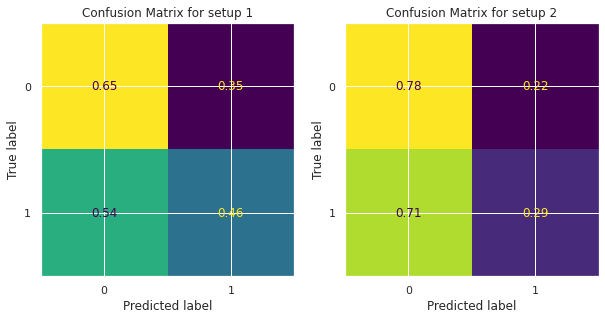

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2);
fig.set_figheight(5);
fig.set_figwidth(10);
ax1.set_title('Confusion Matrix for setup 1')
ax2.set_title('Confusion Matrix for setup 2')
ConfusionMatrixDisplay.from_estimator(clf1, test[['groundelev', 'buildings_area']].to_numpy().astype('float'), test['status'].to_numpy().astype('int'),normalize='true',ax=ax1,colorbar=False);
ConfusionMatrixDisplay.from_estimator(clf2, test[['cnstrct_yr', 'heightroof']].to_numpy().astype('float'), test['status'].to_numpy().astype('int'),normalize='true',ax=ax2,colorbar=False);
plt.show()
#ROW NORMALIZED!!!

The confusion matrix for both setups prove that the logistic regression is not a good method for predicting the labels of the infectious status of buildings (at least with the data fields used).

So lets bring in another variable that needs to be coded for. The distance between buildings to their nearest public park might support a partition of the data as rats are widely seen in many parks throughout the city.

In [ ]:
filename = "manhattan_island_parks.geojson"
file = open(filename)
parks_df = gpd.read_file(file)
parks_df['source_id'] = parks_df.source_id.astype(int)
parks_df = parks_df.fillna(value=np.nan)
parks_df = parks_df[parks_df['parknum'].notna()]
parks_df = gpd.GeoDataFrame(parks_df,geometry='geometry')
parks_df['latitude'] = parks_df['geometry'].to_crs(epsg=4326).centroid.y
parks_df['longitude'] = parks_df['geometry'].to_crs(epsg=4326).centroid.x
df = parks_df.sort_values(['longitude', 'latitude'], ascending=[True, False])
parks_df = df
parks_df = parks_df.reset_index(drop=True)
del df
clear_output()

In [ ]:
#changing geometry to epsg:4326 to be able to find distance between a point and a polygon
parks_df['geometry'] = parks_df['geometry'].to_crs(epsg=4326)

In [ ]:
parks_df.head(2)

,shape_area,landuse,shape_leng,parknum,park_name,feat_code,status,sub_code,source_id,geometry,latitude,longitude
0,2565.77081022,Community Park,212.840620484,M283A,Battery Park City,4910,Unchanged,491000,12491000613,"MULTIPOLYGON (((-74.01757 40.71214, -74.01762 ...",40.712055,-74.017659
1,17898.3607113,Community Park,624.203766469,M283,Battery Park City,4980,Updated,498000,12498000447,"MULTIPOLYGON (((-74.01706 40.70918, -74.01710 ...",40.709340,-74.017408


Below can be seen a visualization of the data contained in the public parks polygon database.

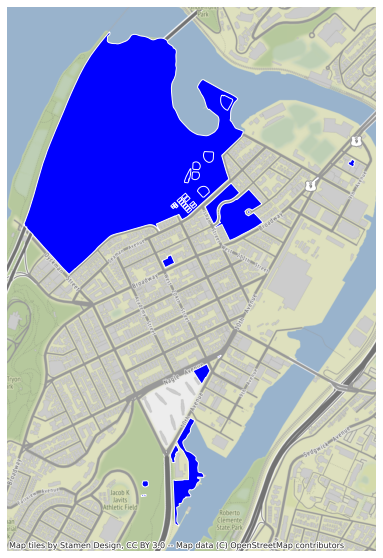

In [ ]:
ax = parks_df[1758:1798].to_crs(epsg=3857).plot(figsize=(10, 10), alpha=1.0, color='blue');
cx.add_basemap(ax,zoom=16); ax.axis('off');

Pre-calculate geoseries for each polygon (basically convert a polygon into a series of points(lat,long), specifically those on the border lines of the polygons).

In [ ]:
geo_df['nearest_park'] = 0.25 #km
geo_df['area_of_park'] = 0 #area
parks_df['Geo_Series'] = gpd.GeoSeries(parks_df['geometry']) #shape

geo_df['GPS_point'] = Point(geo_df['longitude'].iloc[0], geo_df['latitude'].iloc[0])
for i in range(0,geo_df.shape[0]):
  geo_df['GPS_point'].iloc[i] = Point(geo_df['longitude'].iloc[i], geo_df['latitude'].iloc[i])
geo_df['GPS_point'] = gpd.GeoSeries(geo_df['GPS_point'])
clear_output()

Calculate and find the shortest distance between each building and the nearest public park, also capture the area of the park.

This method below (loops through a dataframe) has become to slow for the search of nearest neighbors, reason for delegating neighbor searches to a kd-tree structure in future calculations.  

In [ ]:
i = 0
for r in geo_df['GPS_point']:
  j = 0
  for R in parks_df['Geo_Series']:
    D = R.distance(r);
    if D < geo_df['nearest_park'].iloc[i] :
      geo_df['nearest_park'].iloc._setitem_with_indexer(i, D)
      geo_df['area_of_park'].iloc._setitem_with_indexer(i, parks_df['geometry'].iloc[j].area)
    j = j + 1
  i = i + 1
clear_output()

Save data

In [ ]:
geo_df.to_pickle('geo_with_park_info.pkl') #Save this data as it is very time consuming to generate it.

In [ ]:
#Load data
df_ = pd.read_pickle('geo_with_park_info.pkl')
geo_df = gpd.GeoDataFrame(df_,geometry='geometry')
#del df_

Create a field that captures the distance to the nearest park and the area of the park. The idea here is that the bigger a park the more

In [ ]:
geo_df['z_measure'] = geo_df['area_of_park']/geo_df['nearest_park']
maximo = np.ma.masked_invalid(geo_df['z_measure']).max()
geo_df.replace(np.inf,maximo)
geo_df['buildings_area'] = geo_df.geometry.area

In [ ]:
geo_df[7:8]

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude,block,color_report,status,nearest_park,area_of_park,GPS_point,z_measure,buildings_area,inspection_date,area
7,1022440001,35,1985.0,6.0,"MULTIPOLYGON (((-8228511.545 4993716.474, -822...",40.8735,-73.918,2244,#01DF3A,Passed,0.00058,0.000075,POINT (-73.91805 40.87354),0.129485,415.02932,2019-10-04 16:15:05,2725.946072


Buildings that have failed a sanitation inspection due to other reasons and those with no recent inspections (within the timestamps used for this project) are removed from the data to make use of data that is properly labeled.

In [ ]:
regression_df = pd.DataFrame(geo_df[geo_df['status']!='Failed for Other R']) #remove failed for other reasons.
regression_df = regression_df[regression_df['status']!='_blank_'] #remove buildings with no recent inspections.
regression_df =  regression_df.drop(columns=['geometry', 'color_report','base_bbl','block'])
regression_df = regression_df.dropna()
regression_df['heightroof'] = pd.to_numeric(regression_df['heightroof'], downcast="float")

regression_df.loc[(regression_df.status == 'Passed'),'status'] = 0
regression_df.loc[(regression_df.status != 0),'status'] = 1
regression_df = regression_df.sort_values('status', ascending=True)
regression_df = regression_df.reset_index(drop=True)

Visually it seems that the distance to the nearest park does not partition the data any further than before. Next we bring in data from sanitation inspections of restaurants.

In [ ]:
mask = (regression_df['z_measure'] < 0.025) & (regression_df['buildings_area'] < 10000)
df_ = regression_df[mask]
fig = px.scatter_3d(df_, x='cnstrct_yr', y='z_measure', z='heightroof', color='status', size_max=0.5, opacity=0.1)
fig.show()

##K-D TREE search and restaurant data 🍞 🍖 🍗 🍔 🍟 🍕 🍳 🍲 🍱 🍘
KF trees enables a quick search of spacial location data, this accelerates the search of nearest neighbors exponentially in comparison to a dataframe search.

Data provided by ABCEats program is used to collect all the dates of inspections to a food establishment and with this their location and the score for each inspection.

In [ ]:
data_mat = pd.read_csv('DOHMH_New_York_City_Restaurant_Inspection_Results.csv')
restaurant_df = pd.DataFrame(data_mat)
restaurant_df = restaurant_df[restaurant_df.BORO == 'Manhattan']
restaurant_df = restaurant_df[restaurant_df['INSPECTION DATE'].notna()]
restaurant_df = restaurant_df[restaurant_df['SCORE'].notna()]
restaurant_df = restaurant_df[restaurant_df['DBA'].notna()]
restaurant_df = restaurant_df[restaurant_df['Latitude'] != 0]
restaurant_df = restaurant_df[restaurant_df.BBL < 1099999999]
restaurant_df['INSPECTION DATE'] = pd.to_datetime(restaurant_df['INSPECTION DATE'], format='%m/%d/%Y')#.timestamp()
mask = (restaurant_df['INSPECTION DATE'] > '09/01/2017') & (restaurant_df['INSPECTION DATE'] <= '03/07/2020')
restaurant_df = restaurant_df.loc[mask]
restaurant_df = restaurant_df.sort_values(['Latitude', 'Longitude', 'INSPECTION DATE'], ascending=[False, True, False])
restaurant_df.drop_duplicates(subset=['DBA','INSPECTION DATE'], keep='first', inplace=True)
restaurant_df = restaurant_df.drop(columns=['ACTION','VIOLATION CODE','VIOLATION DESCRIPTION','GRADE','GRADE DATE','RECORD DATE','INSPECTION TYPE','CRITICAL FLAG'])

df_1=restaurant_df.groupby(['DBA'], sort=False)['INSPECTION DATE'].apply(list).reset_index()
df_2=restaurant_df.groupby(['DBA'], sort=False)['SCORE'].apply(list).reset_index()

restaurant_df = restaurant_df.drop(columns=['INSPECTION DATE','SCORE'])
restaurant_df.drop_duplicates(subset=['DBA'], keep='first', inplace=True)
restaurant_df = restaurant_df.reset_index(drop=True)
restaurant_df['INSPECTION DATEs'] = df_1['INSPECTION DATE']
restaurant_df['SCOREs'] = df_2['SCORE']
del df_1, df_2

In [ ]:
restaurant_df['GPS_point'] = Point(restaurant_df['Longitude'].iloc[0], restaurant_df['Latitude'].iloc[0])
for i in range(0,restaurant_df.shape[0]):
  restaurant_df['GPS_point'].iloc[i] = Point(restaurant_df['Longitude'].iloc[i], restaurant_df['Latitude'].iloc[i])
restaurant_df = gpd.GeoDataFrame(restaurant_df, geometry='GPS_point')
restaurant_df = restaurant_df.set_crs(epsg=4326, inplace=True)
clear_output()

In [ ]:
restaurant_df[0:2]

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,INSPECTION DATEs,SCOREs,GPS_point
0,41339471,INDIAN ROAD CAFE,Manhattan,600,WEST 218 STREET,10034.0,9172702950,American,40.872893,-73.918180,112.0,10.0,30700.0,1065082.0,1.022500e+09,MN01,"[2020-02-15 00:00:00, 2019-01-08 00:00:00, 201...","[18.0, 30.0, 13.0, 38.0]",POINT (-73.91818 40.87289)
1,50050873,"COLUMBIA UNIVERSITY BAKER ATHLETICS COMPLEX, S...",Manhattan,533,WEST 218 STREET,10034.0,2128548324,Hotdogs,40.871923,-73.915806,112.0,10.0,29700.0,1082066.0,1.022440e+09,MN99,[2019-09-28 00:00:00],[2.0],POINT (-73.91581 40.87192)


Again remove builings that faild for other reasons or those with no inspection data.

In [ ]:
geo_df_with_status = pd.DataFrame(geo_df[geo_df['status']!='Failed for Other R'])
geo_df_with_status = geo_df_with_status[geo_df_with_status['status']!='_blank_']
geo_df_with_status = geo_df_with_status.reset_index(drop=True)
nA = np.array(list(geo_df_with_status.GPS_point.apply(lambda x: (x.x, x.y))))
nB = np.array(list(restaurant_df.geometry.apply(lambda x: (x.x, x.y))))
Kd = cKDTree(nB)

Using the score of health inspection of the nearest 10 restaurants if the health inspection for the restaurants was before the health inspection for each building.

In [ ]:
geo_df_with_status['R_score'] = 0
geo_df_with_status['number_of_restaurants'] = 0
K = 20

for i in range(0,nA.shape[0]):
  dist, index = Kd.query(nA[i], k=K)
  D = 0
  score = 0
  review_date = geo_df_with_status['inspection_date'].iloc[i]
  count = 0
  r_score = 0
  for ind in index:
    l = len(restaurant_df['INSPECTION DATEs'].iloc[ind])
    for j in range(0,l):
      flag = 0
      if review_date > restaurant_df['INSPECTION DATEs'].iloc[ind][j]:
        if review_date - restaurant_df['INSPECTION DATEs'].iloc[ind][j] < pd.Timedelta('90 days'):
          D = D + haversine(nA[i][0],nA[i][1],restaurant_df['Longitude'][ind],restaurant_df['Latitude'][ind])
          if D < 0.182:
            score = score + restaurant_df['SCOREs'][ind][j]
            r_score = r_score + score/D
            count = count + 1
            flag = 1
        if flag == 1:
          break #only want the first occurance

  geo_df_with_status['R_score'].iloc._setitem_with_indexer(i, r_score)
  geo_df_with_status['number_of_restaurants'].iloc._setitem_with_indexer(i, count)

clear_output()

In [ ]:
geo_df_with_status = geo_df_with_status[geo_df_with_status['number_of_restaurants'] != 0]
geo_df_with_status = geo_df_with_status.reset_index(drop=True)
geo_df_with_status['R_score'] = geo_df_with_status['R_score']/geo_df_with_status['number_of_restaurants'] #scaled by number of samples

In [ ]:
geo_df_with_status[20200:20201]

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude,block,color_report,status,nearest_park,area_of_park,GPS_point,z_measure,buildings_area,inspection_date,area,R_score,number_of_restaurants
20200,1014360008,56.88,1940.0,56.0,"MULTIPOLYGON (((-8233464.234 4977266.391, -823...",40.7617,-73.9626,1436,#01DF3A,Passed,0.000185,2.035482e-09,POINT (-73.96257 40.76171),0.000011,282.779485,2020-02-18 12:55:23,1860.452324,344.301132,1


In [ ]:
regression_df = pd.DataFrame(geo_df_with_status)
regression_df =  regression_df.drop(columns=['geometry', 'color_report','base_bbl','block'])
regression_df = regression_df.dropna()
regression_df['heightroof'] = pd.to_numeric(regression_df['heightroof'], downcast="float")

regression_df.loc[(regression_df.status == 'Passed'),'status'] = 0
regression_df.loc[(regression_df.status != 0),'status'] = 1
regression_df = regression_df.sort_values('status', ascending=True)
regression_df = regression_df.reset_index(drop=True)

Yet again a new measure that consideres the average of the nearest 10* restaurants score and the average distance to these.

In [ ]:
mask = (regression_df['R_score'] < 2000) & (regression_df['heightroof'] < 600) & (regression_df['cnstrct_yr'] > 1800)
df_ = regression_df[mask]
fig = px.scatter_3d(df_, x='cnstrct_yr', y='R_score', z='heightroof', color='status', size_max=0.5, opacity=0.1)
fig.show()

###Support Vector Machine
using non-linear kernels

Create test and training datasets. For this part of this project the number of infected and clean builidngs samples are randomly evened out (same amount of positive and negative samples) to avoid issues during training the parameters for the support vectors.

In [ ]:
maximo = np.ma.masked_invalid(regression_df['z_measure']).max()
regression_df = regression_df.replace(np.inf,maximo)

infected = regression_df[regression_df['status'] == 1]
clean = regression_df[regression_df['status'] == 0]

infected_train, infected_test = train_test_split(infected[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','status']], random_state=10 ,test_size=0.15)
clean_train, clean_test = train_test_split(clean[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','status']], random_state=10, test_size=0.15)
train = infected_train.append(clean_train[0:infected_train.shape[0]]) #even out the pos and neg samples
test = infected_test.append(clean_test[0:infected_test.shape[0]]) #even out the pos and neg samples

The number of fields used in this part of the projects is larger than during the logitic regression testing.

In [ ]:
X = train[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants']].to_numpy().astype('float')
y = train['status'].to_numpy().astype('int')

In [ ]:
clf3 = make_pipeline(StandardScaler(), SVC(C=500,kernel='rbf',degree=4,gamma='scale'))
clf3.fit(X,y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(C=500, degree=4))])

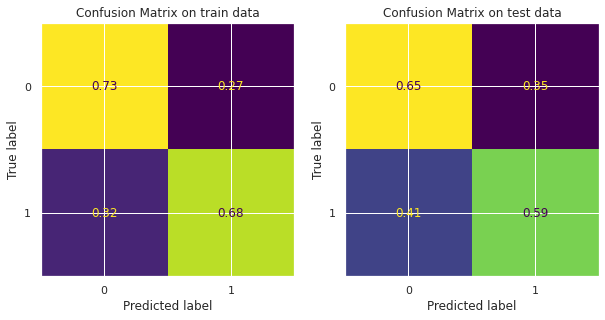

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2);
fig.set_figheight(5);
fig.set_figwidth(10);
ax1.set_title('Confusion Matrix on train data')
ax2.set_title('Confusion Matrix on test data')

ConfusionMatrixDisplay.from_estimator(clf3, X, y,normalize='true',ax=ax1,colorbar=False);

X = test[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants']].to_numpy().astype('float')
y = test['status'].to_numpy().astype('int')
ConfusionMatrixDisplay.from_estimator(clf3, X, y,normalize='true',ax=ax2,colorbar=False);
plt.show()
#ROW NORMALIZED!!!

Multiple kernels were tested (linear, radial bias function (rbf), polynomial(degrees: 3, 4, 5) and sigmoid) from which the best performing kernel was rbf. As seen above it does perform better at classifying data when compared to the results offered by the logistic regression method.

##SUBWAY LINES 🚂

We introduce one last dataset of information into this project, the location of subwaylines in the Island of Manhattan. This data will enable to probe if buildings near subway lines are prone to be infested more than those not near lines. "Near" in this case means if the center of a building is not more than 182 meters away from a segment of subway line. This distance was specified previously as the fardest distance a rat will travel from its nest.

In [ ]:
trains_df = gpd.read_file('train_lines.geojson')
trains_df =  trains_df.drop(columns=['URL', 'NAME','ID','OBJECTID'])
trains_df['latitude'] = trains_df['geometry'].centroid.y
trains_df['longitude'] = trains_df['geometry'].centroid.x
trains_df = trains_df.sort_values(['latitude', 'longitude'], ascending=[False, True])
trains_df['GPS_point'] = trains_df['geometry'].apply(lambda x: x.centroid)
trains_df['GPS_point'] = trains_df['GPS_point'].to_crs(epsg=3857)
trains_df = trains_df.reset_index(drop=True)
clear_output()

An example of a row from the subway line dataframe, this example shows information for a section of the B subway line in lower Manhattan

In [ ]:
trains_df[174:175] #SHAPE_LEN is given in feet

,RT_SYMBOL,SHAPE_LEN,geometry,latitude,longitude,GPS_point
174,B,2352.354566,"MULTILINESTRING ((-73.99375 40.71827, -73.9920...",40.72132,-73.992456,POINT (-8236802.548 4971322.891)


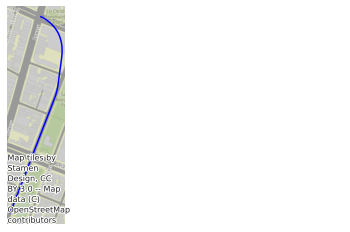

In [ ]:
ax = trains_df[174:175].to_crs(epsg=3857).plot(alpha=1.0, color='blue');
cx.add_basemap(ax,zoom=17); ax.axis('off');

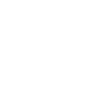

In [ ]:
trains_df['geometry'].iloc[174]

Create a radial area (shapely polygon) around each building.

In [ ]:
circles_df = geo_df_with_status['GPS_point'] #these two datafarmes have the same indexing
circles_df = gpd.GeoDataFrame(circles_df)
circles_df = circles_df.set_geometry(col='GPS_point').set_crs(epsg=4326, inplace=True)
circles_df = circles_df.to_crs(epsg=3857)
circles_df['circle'] = circles_df['GPS_point'].apply(lambda x: x.buffer(182, resolution=3))#x.buffer(216, resolution=3))
circles_df = circles_df.set_geometry(col='circle').to_crs(epsg=4326)

In [ ]:
circles_df.head(1)

,GPS_point,circle
0,POINT (-8228720.003 4993749.582),"POLYGON ((-73.91821 40.87383, -73.91843 40.873..."


And below can be seen the center of a building, the radial area with a radius of ~182 meteres surrounding it and a subwayline.

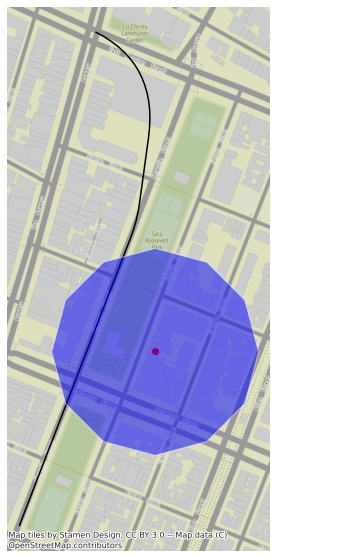

In [ ]:
fig, ax = plt.subplots(1, figsize=(10, 10));
trains_df[174:175].to_crs(epsg=3857).plot(ax=ax, color='black', alpha=1.0, zorder=1);
circles_df['GPS_point'][-2990:-2989].to_crs(epsg=3857).plot(ax=ax, color='red', alpha=1.0, zorder=2);
circles_df[-2990:-2989].to_crs(epsg=3857).plot(ax=ax, color='blue', alpha=0.5, zorder=3);
cx.add_basemap(ax);
ax.axis('off');

The length of a subway line within the circular area of a building can be calculated:

In [ ]:
circles_df['circle'].iloc[-2990].intersection(trains_df['geometry'].iloc[174]).length*100000 #transfor to meters

198.97248958514743

lets load the geo location centers for the both the building and subway lines data

In [ ]:
mA = np.array(list(circles_df.GPS_point.apply(lambda x: (x.x, x.y))))
mB = np.array(list(trains_df.GPS_point.apply(lambda x: (x.x, x.y))))
Kd_train = cKDTree(mB)

In [ ]:
geo_df_with_status['subwayness'] = 0
K = 10

for i in range(0,mA.shape[0]):
  dist, index = Kd_train.query(mA[i], k=K)
  L = 0
  count = 0
  for ind in index:
    L = L + circles_df['circle'].iloc[i].intersection(trains_df['geometry'].iloc[ind]).length

  geo_df_with_status['subwayness'].iloc._setitem_with_indexer(i, L)

geo_df_with_status['subwayness'] = geo_df_with_status['subwayness']*100000
clear_output()

In [ ]:
geo_df_with_status[12005:12007]

,base_bbl,heightroof,cnstrct_yr,groundelev,geometry,latitude,longitude,block,color_report,status,nearest_park,area_of_park,GPS_point,z_measure,buildings_area,inspection_date,area,R_score,number_of_restaurants,subwayness
12005,1016240060,66.446914,1940.0,60.0,"MULTIPOLYGON (((-8232172.670 4980919.523, -823...",40.7866,-73.9511,1624,#01DF3A,Passed,0.000886,3.289361e-07,POINT (-73.95106 40.78657),0.000371,947.414860,2019-06-06 16:06:09,6230.864262,582.887650,2,243.402365
12006,1012160016,60.8,1977.0,91.0,"MULTIPOLYGON (((-8234731.875 4980914.530, -823...",40.7866,-73.974,1216,#FAAC58,Bait applied,0.002689,1.796084e-07,POINT (-73.97398 40.78657),0.000067,553.885069,2019-09-05 09:46:37,3642.736390,26.789204,1,0.000000


In [ ]:
regression_df = pd.DataFrame(geo_df_with_status)
regression_df =  regression_df.drop(columns=['geometry', 'color_report','base_bbl','latitude','longitude'])
regression_df = regression_df.dropna()
regression_df['heightroof'] = pd.to_numeric(regression_df['heightroof'], downcast="float")

regression_df.loc[(regression_df.status == 'Passed'),'status'] = 0
regression_df.loc[(regression_df.status != 0),'status'] = 1
regression_df = regression_df.sort_values('status', ascending=True)
regression_df = regression_df.reset_index(drop=True)
clear_output()

In [ ]:
mask = (regression_df['R_score'] < 2000) & (regression_df['cnstrct_yr'] > 1800)
df_ = regression_df[mask]
fig = px.scatter_3d(df_, x='cnstrct_yr', y='R_score', z='subwayness', color='status', size_max=0.5, opacity=0.1)
fig.show()

In [ ]:
the_blocks = regression_df.block.unique()
import random
random.seed(105)
block_test = random.choices(the_blocks,k=3)

In [ ]:
maximo = np.ma.masked_invalid(regression_df['z_measure']).max()
regression_df_ = regression_df.replace(np.inf,maximo)

regression_df_ = regression_df_[regression_df_.block != block_test[0]]
regression_df_ = regression_df_[regression_df_.block != block_test[1]]
regression_df_ = regression_df_[regression_df_.block != block_test[2]]

infected = regression_df_[regression_df_['status'] == 1]
clean = regression_df_[regression_df_['status'] == 0]

infected_train, infected_test = train_test_split(infected[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness','status']], random_state=10 ,test_size=0.15)
clean_train, clean_test = train_test_split(clean[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness','status']], random_state=10, test_size=0.15)
train = infected_train.append(clean_train[0:infected_train.shape[0]]) #even out the pos and neg samples
test = infected_test.append(clean_test[0:infected_test.shape[0]]) #even out the pos and neg samples

In [ ]:
X = train[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']].to_numpy().astype('float')
y = train['status'].to_numpy().astype('int')

In [ ]:
clf3 = make_pipeline(StandardScaler(), SVC(C=500,kernel='rbf',degree=4,gamma='scale'))
clf3.fit(X,y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('svc', SVC(C=500, degree=4))])

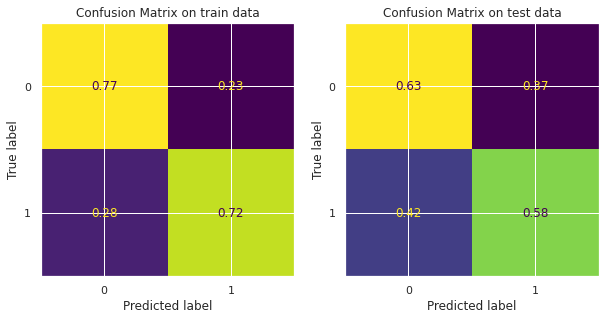

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2);
fig.set_figheight(5);
fig.set_figwidth(10);
ax1.set_title('Confusion Matrix on train data')
ax2.set_title('Confusion Matrix on test data')

ConfusionMatrixDisplay.from_estimator(clf3, X, y,normalize='true',ax=ax1,colorbar=False);

X = test[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']].to_numpy().astype('float')
y = test['status'].to_numpy().astype('int')
ConfusionMatrixDisplay.from_estimator(clf3, X, y,normalize='true',ax=ax2,colorbar=False);
plt.show()
#ROW NORMALIZED!!!

##Testing system


###Predicting infested buildings
given n blocks (3 for this sample) which one should be inspect next???

In [ ]:
p = np.zeros(3)
c = np.zeros(3)
i = 0
for b in block_test:
  regression_df_p = regression_df[regression_df.block == b]
  regression_df_p = regression_df_p[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']]
  p[i] = clf3.predict(regression_df_p).sum()/regression_df_p.shape[0]
  i = i + 1
clear_output()

In [ ]:
regression_df = gpd.GeoDataFrame(geo_df_with_status,geometry='geometry')
regression_df = regression_df.dropna()
regression_df['heightroof'] = pd.to_numeric(regression_df['heightroof'], downcast="float")

regression_df.loc[(regression_df.status == 'Passed'),'status'] = 0
regression_df.loc[(regression_df.status != 0),'status'] = 1
regression_df = regression_df.sort_values('status', ascending=True)
regression_df = regression_df.reset_index(drop=True)

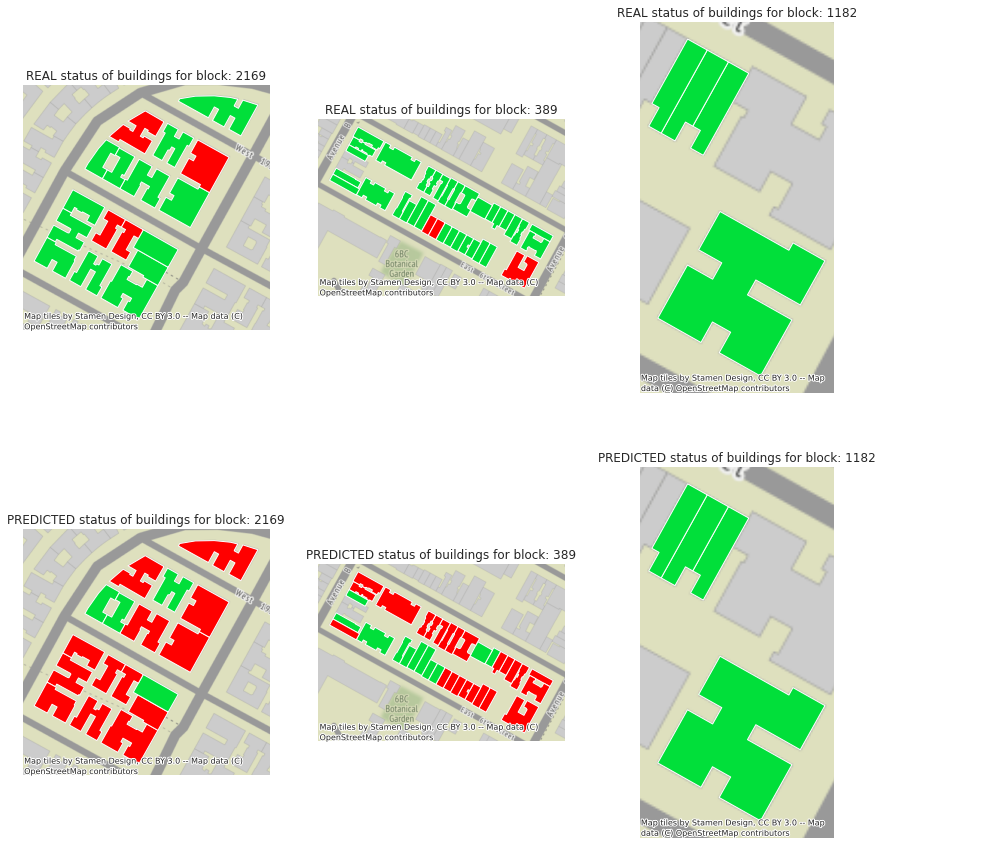

In [ ]:
fig, ax = plt.subplots(1, figsize=(15, 15));
for i in range(0,6):
    # create subplot axes in a 2x3 grid
    ax = plt.subplot(2, 3, i + 1) # nrows, ncols, axes position
    # plot the site on these axes
    if i <= 2:
      regression_df_ = regression_df[regression_df.block == block_test[i]]
      regression_df_.color_report[regression_df_['status']==0] = '#01DF3A'
      regression_df_.color_report[regression_df_['status']==1] = '#FF0000'
      regression_df_.plot(alpha=1.0, color=regression_df_['color_report'],ax=ax)
      cx.add_basemap(ax)
      ax.axis('off')
      ax.set_title('REAL status of buildings for block: '+str(block_test[i]))
    else:
      j = i - 3
      regression_df_ = regression_df[regression_df.block == block_test[j]]
      regression_df_['status'] = clf3.predict(regression_df_[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']])
      regression_df_.color_report[regression_df_['status']==0] = '#01DF3A'
      regression_df_.color_report[regression_df_['status']==1] = '#FF0000'
      regression_df_.plot(alpha=1.0, color=regression_df_['color_report'],ax=ax)
      cx.add_basemap(ax)
      ax.axis('off')
      ax.set_title('PREDICTED status of buildings for block: '+str(block_test[j]))
clear_output()
plt.show()

The predicted percentage of infestation for 3 different blocks

In [ ]:
print ('Blocks '+str(block_test)+' are predicted to have a infested percentage of: '+str(p))
print ('Please send inspectors to block '+str(block_test[np.argmax(p, axis=0)]))

Blocks [2169, 389, 1182] are predicted to have a infested percentage of: [0.76470588 0.68571429 0.        ]
Please send inspectors to block 2169


###Infested rate of neighborhood
Of the analyzed block which one is located in the most highly infested neighborhood.

Histogram of infected percentage for all manhattan blocks

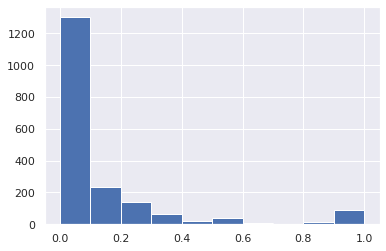

In [ ]:
neighbor_blocks = network_df
infested_rate = np.zeros(neighbor_blocks.shape[0])
j = 0
for i in neighbor_blocks.block:
  rdf = regression_df[regression_df['block']==i]
  if rdf.shape[0] != 0:
    infested_rate[j] = rdf['status'].sum() / rdf.shape[0]
  else:
    infested_rate[j] = 0
  j = j + 1

plt.hist(infested_rate)
clear_output()
plt.show()

In [ ]:
edges_test = edges_df[edges_df['start_block']==block_test[1]]

Show the status of neighbor block, if the ratio of infestation is above 33% the block (circle) is colored red

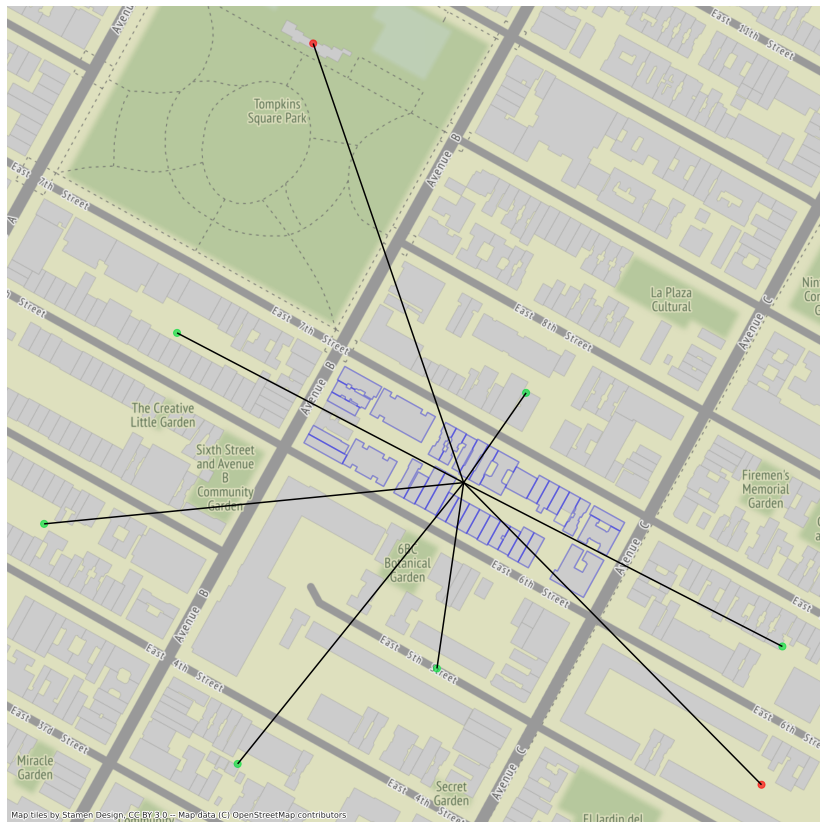

In [ ]:
lista = [(network_df['block'] == i).idxmax() for i in edges_test.end_block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]
neighbor_blocks = network_df.loc[lista]
neighbor_blocks['color'] = '#FF0000'
regression_df_.color_report[regression_df_['status']==1] = '#FF0000'
for i in neighbor_blocks.block:
  rdf = regression_df[regression_df['block']==i]
  if rdf.shape[0] != 0:
    infested_rate = rdf['status'].sum() / rdf.shape[0]
  else:
    infested_rate = 0
  if infested_rate > 0.33:
    neighbor_blocks.color[neighbor_blocks['block']==i] = '#FF0000'
  else:
    neighbor_blocks.color[neighbor_blocks['block']==i] = '#01DF3A'
clear_output()
makeLayeredMap(regression_df[regression_df['block']==block_test[1]],neighbor_blocks,edges_test)


In [ ]:
infested_rate = np.zeros(len(block_test))
j = 0
for blocks in block_test:
  edges_test = edges_df[edges_df['start_block']==blocks]
  lista = [(network_df['block'] == i).idxmax() for i in edges_test.end_block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]
  neighbor_blocks = network_df.loc[lista]
  count = 0
  for i in neighbor_blocks.block:
    rdf = regression_df[regression_df['block']==i]
    if rdf.shape[0] != 0:
      count = count + rdf['status'].sum() / rdf.shape[0]
    else:
      count = count + 0
  infested_rate[j] = count/neighbor_blocks.shape[0]
  j = j + 1

In [ ]:
print ('The neighboring blocks of blocks '+str(block_test)+' have an infested rate of: '+str(infested_rate))
print ('Block '+str(block_test[np.argmax(infested_rate, axis=0)])+' is located in a highly infested neighborhood')

The neighboring blocks of blocks [2169, 389, 1182] have an infested rate of: [0.0620938  0.22987685 0.00869565]
Block 389 is located in a highly infested neighborhood


###Rat gangs of the infestd buildings
Do the predicted infested buildings belong to a larger rat nest or do these form their own nest.
If these belong to a larger nest it will be recommend to also inspect those buildings belonging to the nest (out side the block being analyzed).

In [ ]:
blocks = block_test[np.argmax(p, axis=0)]
#blocks = block_test[1]

infested_rate = np.zeros(len(block_test))
edges_test = edges_df[edges_df['start_block']==blocks]
lista = [(network_df['block'] == i).idxmax() for i in edges_test.end_block.unique() if (network_df.index[network_df['block'] == i].tolist() != [])]
neighbor_blocks = network_df.loc[lista]
df = gpd.GeoDataFrame(columns=regression_df.columns)
for i in neighbor_blocks.block:
    rdf = regression_df[regression_df['block']==i]
    df = df.append(rdf)
rdf = regression_df[regression_df['block']==blocks]
rdf['status'] = clf3.predict(rdf[['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']])
rdf_hold = rdf
rdf_hold = rdf_hold[rdf_hold.status == 1]
df = df.append(rdf)
df = df.reset_index(drop=True)
neighborhood_df = gpd.GeoDataFrame(df,geometry='geometry')
neighborhood_df['x'] = neighborhood_df['geometry'].centroid.x
neighborhood_df['y'] = neighborhood_df['geometry'].centroid.y
clear_output()
del df

In [ ]:
neighborhood_df = neighborhood_df[neighborhood_df.status == 1]
nnn = skl.cluster.AgglomerativeClustering(n_clusters=None,distance_threshold=105,linkage='single',affinity='euclidean').fit(neighborhood_df[['x','y']])

In [ ]:
color_codes = [None]*np.unique(nnn.labels_)[-1]
r = lambda: np.random.randint(0,255)
for i in range(0,np.unique(nnn.labels_)[-1]):
  color_codes[i] = ('#%02X%02X%02X' % (r(),r(),r()))
for i in range(0,nnn.labels_.shape[0]):
  f = color_codes[nnn.labels_[i]-1]
  neighborhood_df['color_report'].iloc._setitem_with_indexer(i, f)
clear_output()

(-8230035.956560338, -8229640.156599436, 4990681.892657401, 4991434.754220001)

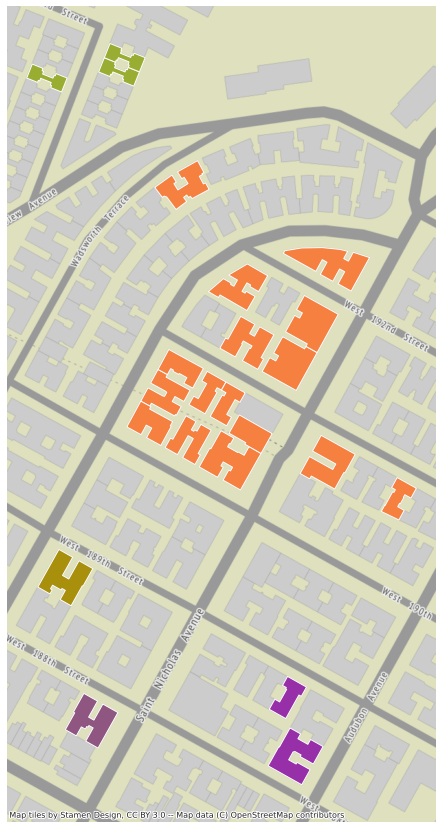

In [ ]:
ax = neighborhood_df.plot(figsize=(15, 15), alpha=1.0, color=neighborhood_df['color_report'])
cx.add_basemap(ax)
ax.axis('off')

In [ ]:
colors = neighborhood_df[-int(rdf_hold.shape[0]):-1].color_report.unique()
remaining_neighborhood_df = neighborhood_df[0:-int(rdf_hold.shape[0])]
bbl = []
for i in colors:
  bbl.append(remaining_neighborhood_df.base_bbl[remaining_neighborhood_df.color_report == i].to_list())
if len(bbl) ==0:
  print ('There are no other buildings outside of block '+str(block_test[np.argmax(p, axis=0)])+' that form a nest with the buildings in this block.')
else:
  print ('Do consider inspecting the following buildings with unique bbl identifier '+str(bbl[0])+' in the proximity of block'+str(block_test[np.argmax(p, axis=0)]))

Do consider inspecting the following buildings with unique bbl identifier [1021700353, 1021610126, 1021610004] in the proximity of block2169


##PRINCIPAL COMPONENT ANALYSIS

In [ ]:
features = ['cnstrct_yr', 'heightroof','groundelev','buildings_area','R_score','z_measure','number_of_restaurants','subwayness']
train_ord = train.reset_index(drop=True)
# Separating out the features
x = train_ord.loc[:, features].values
# Separating out the target
y = train_ord.loc[:,['status']].values
# Standardizing the features
x = StandardScaler().fit_transform(x)

In [ ]:
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
finalDf = pd.concat([principalDf, train_ord['status']], axis = 1)

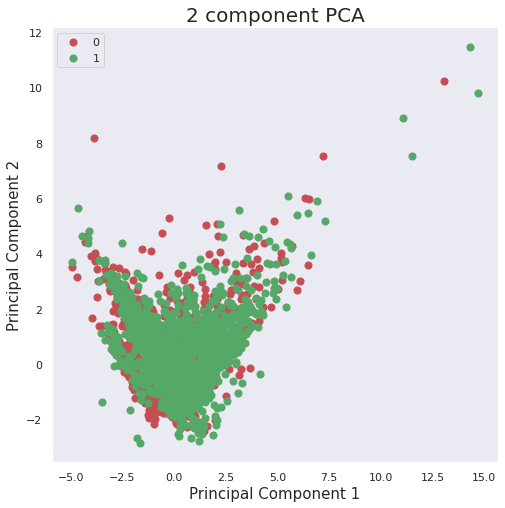

In [ ]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1)
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = [0,1]
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['status'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1'], finalDf.loc[indicesToKeep, 'principal component 2'], c = color, s = 50)
ax.legend(targets)
ax.grid()

In [ ]:
pca3 = PCA(n_components=3)
principalComponents3 = pca3.fit_transform(x)
principalDf3 = pd.DataFrame(data = principalComponents3, columns = ['principal component 1', 'principal component 2','principal component 3'])
finalDf3 = pd.concat([principalDf3, train_ord['status']], axis = 1)

In [ ]:
mask = (finalDf3['principal component 1'] < 5)
df_ = finalDf3[mask]
fig = px.scatter_3d(df_, title='3 component PCA' ,x='principal component 1', y='principal component 2', z='principal component 3', color='status', size_max=0.1, opacity=0.1)
fig.show()

Based on the first principal component the ground elevation, z_measure and subwayness are not important features.


In [ ]:
pca3.components_[0]

array([ 0.46789303,  0.44053484,  0.07219328,  0.45844525, -0.40465069,
        0.07873455, -0.43714794, -0.10286705])

##🗑️ 🗑️ 🗑️ 🗑️ 🗑️ THE END 🗑️ 🗑️ 🗑️ 🗑️ 🗑️